# Importing needed libraries

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from sklearn import preprocessing

# Happiness Dataset

## Reading all 5 csv files in the Happiness dataset

In [2]:
df_happiness_2015 =  pd.read_csv('./data/Happiness_Dataset/2015.csv')
df_happiness_2016 =  pd.read_csv('./data/Happiness_Dataset/2016.csv')
df_happiness_2017 =  pd.read_csv('./data/Happiness_Dataset/2017.csv')
df_happiness_2018 =  pd.read_csv('./data/Happiness_Dataset/2018.csv')
df_happiness_2019 =  pd.read_csv('./data/Happiness_Dataset/2019.csv')

## Cleaning the Happiness Dataset

### Renaming the columns in each csv file of the Happiness dataset

In [3]:
df_happiness_2015.rename(columns = {'Economy (GDP per Capita)':'GDP', 'Health (Life Expectancy)':'Health','Trust (Government Corruption)':'Trust'}, inplace = True) 
df_happiness_2015=df_happiness_2015.drop(["Standard Error","Region"],axis=1)

In [4]:
df_happiness_2016.rename(columns = {'Economy (GDP per Capita)':'GDP', 'Health (Life Expectancy)':'Health','Trust (Government Corruption)':'Trust'}, inplace = True) 
df_happiness_2016=df_happiness_2016.drop(["Lower Confidence Interval","Upper Confidence Interval","Region"],axis=1)
df_happiness_2016

,Country,Happiness Rank,Happiness Score,GDP,Family,Health,Freedom,Trust,Generosity,Dystopia Residual
0,Denmark,1,7.526,1.44178,1.16374,0.79504,0.57941,0.44453,0.36171,2.73939
1,Switzerland,2,7.509,1.52733,1.14524,0.86303,0.58557,0.41203,0.28083,2.69463
2,Iceland,3,7.501,1.42666,1.18326,0.86733,0.56624,0.14975,0.47678,2.83137
3,Norway,4,7.498,1.57744,1.12690,0.79579,0.59609,0.35776,0.37895,2.66465
4,Finland,5,7.413,1.40598,1.13464,0.81091,0.57104,0.41004,0.25492,2.82596
...,...,...,...,...,...,...,...,...,...,...
152,Benin,153,3.484,0.39499,0.10419,0.21028,0.39747,0.06681,0.20180,2.10812
153,Afghanistan,154,3.360,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
154,Togo,155,3.303,0.28123,0.00000,0.24811,0.34678,0.11587,0.17517,2.13540
155,Syria,156,3.069,0.74719,0.14866,0.62994,0.06912,0.17233,0.48397,0.81789


In [5]:
df_happiness_2017.rename(columns = {'Economy..GDP.per.Capita.':'GDP', 'Health..Life.Expectancy.':'Health','Trust..Government.Corruption.':'Trust','Whisker.low':'Lower Confidence Interval','Whisker.high':'Upper Confidence Interval','Happiness.Rank':'Happiness Rank','Happiness.Score':'Happiness Score','Dystopia.Residual':'Dystopia Residual'}, inplace = True)
df_happiness_2017=df_happiness_2017.drop(["Lower Confidence Interval","Upper Confidence Interval"],axis=1)
df_happiness_2017

,Country,Happiness Rank,Happiness Score,GDP,Family,Health,Freedom,Generosity,Trust,Dystopia Residual
0,Norway,1,7.537,1.616463,1.533524,0.796667,0.635423,0.362012,0.315964,2.277027
1,Denmark,2,7.522,1.482383,1.551122,0.792566,0.626007,0.355280,0.400770,2.313707
2,Iceland,3,7.504,1.480633,1.610574,0.833552,0.627163,0.475540,0.153527,2.322715
3,Switzerland,4,7.494,1.564980,1.516912,0.858131,0.620071,0.290549,0.367007,2.276716
4,Finland,5,7.469,1.443572,1.540247,0.809158,0.617951,0.245483,0.382612,2.430182
...,...,...,...,...,...,...,...,...,...,...
150,Rwanda,151,3.471,0.368746,0.945707,0.326425,0.581844,0.252756,0.455220,0.540061
151,Syria,152,3.462,0.777153,0.396103,0.500533,0.081539,0.493664,0.151347,1.061574
152,Tanzania,153,3.349,0.511136,1.041990,0.364509,0.390018,0.354256,0.066035,0.621130
153,Burundi,154,2.905,0.091623,0.629794,0.151611,0.059901,0.204435,0.084148,1.683024


In [6]:
df_happiness_2018.rename(columns = {'Country or region':'Country','Overall rank':'Happiness Rank', 'Score':'Happiness Score','Healthy life expectancy':'Health','Freedom to make life choices':'Freedom','Social support':'Family','Perceptions of corruption':'Trust','GDP per capita':'GDP'}, inplace = True)
df_happiness_2018['Dystopia Residual']=df_happiness_2018['Happiness Score']-(df_happiness_2018['GDP']+df_happiness_2018['Family']+df_happiness_2018['Health']+df_happiness_2018['Freedom']+df_happiness_2018['Generosity']+df_happiness_2018['Trust'])
df_happiness_2018

,Happiness Rank,Country,Happiness Score,GDP,Family,Health,Freedom,Generosity,Trust,Dystopia Residual
0,1,Finland,7.632,1.305,1.592,0.874,0.681,0.202,0.393,2.585
1,2,Norway,7.594,1.456,1.582,0.861,0.686,0.286,0.340,2.383
2,3,Denmark,7.555,1.351,1.590,0.868,0.683,0.284,0.408,2.371
3,4,Iceland,7.495,1.343,1.644,0.914,0.677,0.353,0.138,2.426
4,5,Switzerland,7.487,1.420,1.549,0.927,0.660,0.256,0.357,2.318
...,...,...,...,...,...,...,...,...,...,...
151,152,Yemen,3.355,0.442,1.073,0.343,0.244,0.083,0.064,1.106
152,153,Tanzania,3.303,0.455,0.991,0.381,0.481,0.270,0.097,0.628
153,154,South Sudan,3.254,0.337,0.608,0.177,0.112,0.224,0.106,1.690
154,155,Central African Republic,3.083,0.024,0.000,0.010,0.305,0.218,0.038,2.488


In [7]:
df_happiness_2019.rename(columns = {'Country or region':'Country','Overall rank':'Happiness Rank', 'Score':'Happiness Score','Healthy life expectancy':'Health','Freedom to make life choices':'Freedom','Social support':'Family','Perceptions of corruption':'Trust','GDP per capita':'GDP'}, inplace = True)
df_happiness_2019['Dystopia Residual']=df_happiness_2019['Happiness Score']-(df_happiness_2019['GDP']+df_happiness_2019['Family']+df_happiness_2019['Health']+df_happiness_2019['Freedom']+df_happiness_2019['Generosity']+df_happiness_2019['Trust'])
df_happiness_2019

,Happiness Rank,Country,Happiness Score,GDP,Family,Health,Freedom,Generosity,Trust,Dystopia Residual
0,1,Finland,7.769,1.340,1.587,0.986,0.596,0.153,0.393,2.714
1,2,Denmark,7.600,1.383,1.573,0.996,0.592,0.252,0.410,2.394
2,3,Norway,7.554,1.488,1.582,1.028,0.603,0.271,0.341,2.241
3,4,Iceland,7.494,1.380,1.624,1.026,0.591,0.354,0.118,2.401
4,5,Netherlands,7.488,1.396,1.522,0.999,0.557,0.322,0.298,2.394
...,...,...,...,...,...,...,...,...,...,...
151,152,Rwanda,3.334,0.359,0.711,0.614,0.555,0.217,0.411,0.467
152,153,Tanzania,3.231,0.476,0.885,0.499,0.417,0.276,0.147,0.531
153,154,Afghanistan,3.203,0.350,0.517,0.361,0.000,0.158,0.025,1.792
154,155,Central African Republic,3.083,0.026,0.000,0.105,0.225,0.235,0.035,2.457


## Merging all csv files of the Happiness dataset into one dataset

In [8]:
df_merged_happiness = pd.concat([df_happiness_2015, df_happiness_2016, df_happiness_2017, df_happiness_2018, df_happiness_2019])
df_merged_happiness = df_merged_happiness.groupby(['Country'], as_index=False).mean()
df_merged_happiness['name'] = df_merged_happiness['Country']
df_happiness =  df_merged_happiness.drop(['Country'], axis=1)

## Saving the cleaned Happiness dataset

In [9]:
df_happiness.to_csv (r'./data/Happiness_Dataset/happiness.csv')

# 250 Country Dataset

## Reading the 250 Country dataset

In [10]:
df_250Country =  pd.read_csv('./data/250 Country Data.csv')
df_250Country

,Unnamed: 0,name,region,subregion,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%)
0,0,Afghanistan,Asia,Southern Asia,27657145,652230.0,27.8,3.1% (2013 est.).,28.1% (2000 est.),6.8% (2013 est.).,35% (2008 est.).
1,1,Åland Islands,Europe,Northern Europe,28875,1580.0,NaN,NaN,NaN,NaN,NaN
2,2,Albania,Europe,Southern Europe,2886026,28748.0,34.5,.7% (2013 est.).,98.7% (2011 est.),1.7% (2013 est.).,16.9% official rate (2013 est.). Note: These a...
3,3,Algeria,Africa,Northern Africa,40400000,2381741.0,35.3,3.1%.,79%,3.9%.,10.3%.
4,4,American Samoa,Oceania,Polynesia,57100,199.0,NaN,3%.,97% (1980 est.),NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
245,245,Wallis and Futuna,Oceania,Polynesia,11750,142.0,NaN,NaN,NaN,NaN,NaN
246,246,Western Sahara,Africa,Northern Africa,510713,266000.0,NaN,NaN,NaN,NaN,NaN
247,247,Yemen,Asia,Western Asia,27478000,527968.0,37.7,3.8%.,65.3% (2011 est.),11.8%.,35% (2003 est.).
248,248,Zambia,Africa,Eastern Africa,15933883,752612.0,54.6,6%.,61.4% (2007 est.),7.1%.,15% (2008 est.).


## Cleaning the 250 Country dataset

### Dropping un-needed column

In [11]:
df_250Country = df_250Country.drop(['Unnamed: 0'], axis=1)

### Extracting strings from the numeric columns and converting them to float (for percentage)

In [12]:
df_250Country['Unemployement(%)'] = df_250Country['Unemployement(%)'].str.extract('([-+]?\d*\.\d+|\d+)',expand=False).astype(float)
df_250Country['Real Growth Rating(%)'] = df_250Country['Real Growth Rating(%)'].str.extract('([-+]?\d*\.\d+|\d+)',expand=False).astype(float)
df_250Country['Literacy Rate(%)'] = df_250Country['Literacy Rate(%)'].str.extract('([-+]?\d*\.\d+|\d+)',expand=False).astype(float)
df_250Country['Inflation(%)'] = df_250Country['Inflation(%)'].str.extract('([-+]?\d*\.\d+|\d+)',expand=False).astype(float)

In [13]:
df_250Country

,name,region,subregion,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%)
0,Afghanistan,Asia,Southern Asia,27657145,652230.0,27.8,3.1,28.1,6.8,35.0
1,Åland Islands,Europe,Northern Europe,28875,1580.0,NaN,NaN,NaN,NaN,NaN
2,Albania,Europe,Southern Europe,2886026,28748.0,34.5,0.7,98.7,1.7,16.9
3,Algeria,Africa,Northern Africa,40400000,2381741.0,35.3,3.1,79.0,3.9,10.3
4,American Samoa,Oceania,Polynesia,57100,199.0,NaN,3.0,97.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
245,Wallis and Futuna,Oceania,Polynesia,11750,142.0,NaN,NaN,NaN,NaN,NaN
246,Western Sahara,Africa,Northern Africa,510713,266000.0,NaN,NaN,NaN,NaN,NaN
247,Yemen,Asia,Western Asia,27478000,527968.0,37.7,3.8,65.3,11.8,35.0
248,Zambia,Africa,Eastern Africa,15933883,752612.0,54.6,6.0,61.4,7.1,15.0


## Saving the cleaned 250 Country dataset

In [14]:
df_250Country.to_csv (r'./data/250_Country.csv')

# Life Expentancey Dataset


## Reading Life Expectancy dataset

### Reading two external datasets to fill nulls

In [15]:
df_life_expectancy = pd.read_csv("./data/Life Expectancy Data.csv")
df_GDP = pd.read_csv("./data/GDP_Dataset1.csv")
df_population = pd.read_csv("./data/Population_Dataset1.csv")

## Cleaning the Life Expectancy dataset

### Dropping the un-needed columns from the external datasets

In [16]:
df_population = df_population.copy().drop(['Country Code', 'Indicator Name', 'Indicator Code', '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968', '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999', '2016', '2017', '2018', '2019', '2020', 'Unnamed: 65'], axis =1)
df_GDP = df_GDP.copy().drop(['Country Code', 'Indicator Name', 'Indicator Code', '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968', '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999', '2016', '2017', '2018', '2019', '2020', 'Unnamed: 65'], axis =1)

### Getting the values that are not in the Life Expectancy dataset

In [17]:
results_population = []
for regin in df_population["Country Name"]:
    if(not(regin in df_life_expectancy["Country"].unique())):
        results_population.append(regin)

results_GDP = []
for regin in df_GDP["Country Name"]:
    if(not(regin in df_life_expectancy["Country"].unique())):
        results_GDP.append(regin)

### Dropping the un-needed values for population and GDP from the external datasets

In [18]:
for j in range (0,len(results_population)):
    df_population = df_population.copy().drop(df_population[df_population['Country Name']==results_population[j]].index,axis=0)
    
for j in range (0,len(results_GDP)):
    df_GDP = df_GDP.copy().drop(df_GDP[df_GDP['Country Name']==results_GDP[j]].index,axis=0)

### Getting one column for years and it's corresponding values in the external dataset

In [19]:
df_population = pd.melt(df_population,id_vars=['Country Name'],var_name='Years',value_name='Population')
df_GDP = pd.melt(df_GDP,id_vars=['Country Name'],var_name='Years',value_name='GDP')

### Filling the missing values of population in the original dataset with the values from the population dataset

In [20]:
df_population['Years'] = df_population['Years'].astype(int)
for i in range(0,len(df_life_expectancy['Country'])-1):
    for j in range(0,len(df_population['Country Name'])-1):
        if(df_life_expectancy['Country'][i] == df_population['Country Name'][j]):
            if(df_life_expectancy['Year'][i] == df_population['Years'][j]):
                if((np.isnan(df_life_expectancy['Population'][i])) | (not(np.isnan(df_population['Population'][j])))):
                    df_life_expectancy['Population'][i] = df_population['Population'][j]


### Filling the missing values of GDP in the original dataset with the values from the GDP dataset


In [21]:
df_GDP['Years'] = df_GDP['Years'].astype(int)
for i in range(0,len(df_life_expectancy['Country'])-1):
    for j in range(0,len(df_GDP['Country Name'])-1):
        if(df_life_expectancy['Country'][i] == df_GDP['Country Name'][j]):
            if(df_life_expectancy['Year'][i] == df_GDP['Years'][j]):
                if(np.isnan(df_life_expectancy['GDP'][i]) | (not(np.isnan(df_GDP['GDP'][j])))):
                    df_life_expectancy['GDP'][i] = df_GDP['GDP'][j]

### Aggregating the Life Expectancy dataset using mean values for each country

In [22]:
df_life_expectancy = df_life_expectancy.groupby('Country').mean().reset_index()
df_life_expectancy

,Country,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2007.5,58.19375,269.0625,78.2500,0.014375,34.960110,64.562500,2362.2500,15.51875,...,48.3750,8.252500,52.3125,0.10000,380.473148,2.745116e+07,16.58125,15.58125,0.415375,8.21250
1,Albania,2007.5,75.15625,45.0625,0.6875,4.848750,193.259091,98.000000,53.3750,49.06875,...,98.1250,5.945625,98.0625,0.10000,3218.939465,2.968698e+06,1.61875,1.70000,0.709875,12.13750
2,Algeria,2007.5,73.61875,108.1875,20.3125,0.406667,236.185241,78.000000,1943.8750,48.74375,...,91.7500,4.604000,91.8750,0.10000,3753.086728,3.482137e+07,6.09375,5.97500,0.694875,12.71250
3,Angola,2007.5,49.01875,328.5625,83.7500,5.740667,102.100268,70.222222,3561.3125,18.01875,...,46.1250,3.919333,47.6875,2.36875,2947.288504,2.162286e+07,6.19375,6.66875,0.458375,8.04375
4,Antigua and Barbuda,2007.5,75.05625,127.5000,0.0000,7.949333,1001.585226,98.266667,0.0000,38.42500,...,96.9375,4.791333,98.3125,0.12500,12873.731407,8.480194e+04,3.42500,3.37500,0.488625,8.84375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,Venezuela (Bolivarian Republic of),2007.5,73.38750,163.0000,9.3750,7.420000,0.000000,66.250000,165.0000,54.48750,...,74.6875,4.998667,68.5000,0.10000,8759.732396,2.739287e+07,1.65000,1.56250,0.726812,12.78750
189,Viet Nam,2007.5,74.77500,126.5625,29.1875,3.087333,0.000000,87.538462,4232.9375,11.18750,...,94.9375,5.977333,91.7500,0.14375,1098.591020,8.603401e+07,14.92500,15.62500,0.627063,11.51250
190,Yemen,2007.5,63.86250,211.8125,39.3750,0.047333,0.000000,55.687500,2761.1875,33.48750,...,67.1250,5.005333,72.6250,0.10000,1060.223567,2.173041e+07,13.83125,13.75000,0.475500,8.50625
191,Zambia,2007.5,53.90625,354.3125,33.4375,2.239333,89.650407,69.818182,6563.8125,17.45000,...,64.3750,5.824000,74.2500,11.93125,1088.686392,1.286147e+07,6.88125,6.76250,0.498437,11.21250


### Dropping column (Year)

In [23]:
df_life_expectancy = df_life_expectancy.copy().drop(['Year'],axis=1)
df_life_expectancy

,Country,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,58.19375,269.0625,78.2500,0.014375,34.960110,64.562500,2362.2500,15.51875,107.5625,48.3750,8.252500,52.3125,0.10000,380.473148,2.745116e+07,16.58125,15.58125,0.415375,8.21250
1,Albania,75.15625,45.0625,0.6875,4.848750,193.259091,98.000000,53.3750,49.06875,0.9375,98.1250,5.945625,98.0625,0.10000,3218.939465,2.968698e+06,1.61875,1.70000,0.709875,12.13750
2,Algeria,73.61875,108.1875,20.3125,0.406667,236.185241,78.000000,1943.8750,48.74375,23.5000,91.7500,4.604000,91.8750,0.10000,3753.086728,3.482137e+07,6.09375,5.97500,0.694875,12.71250
3,Angola,49.01875,328.5625,83.7500,5.740667,102.100268,70.222222,3561.3125,18.01875,132.6250,46.1250,3.919333,47.6875,2.36875,2947.288504,2.162286e+07,6.19375,6.66875,0.458375,8.04375
4,Antigua and Barbuda,75.05625,127.5000,0.0000,7.949333,1001.585226,98.266667,0.0000,38.42500,0.0000,96.9375,4.791333,98.3125,0.12500,12873.731407,8.480194e+04,3.42500,3.37500,0.488625,8.84375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,Venezuela (Bolivarian Republic of),73.38750,163.0000,9.3750,7.420000,0.000000,66.250000,165.0000,54.48750,10.7500,74.6875,4.998667,68.5000,0.10000,8759.732396,2.739287e+07,1.65000,1.56250,0.726812,12.78750
189,Viet Nam,74.77500,126.5625,29.1875,3.087333,0.000000,87.538462,4232.9375,11.18750,36.5000,94.9375,5.977333,91.7500,0.14375,1098.591020,8.603401e+07,14.92500,15.62500,0.627063,11.51250
190,Yemen,63.86250,211.8125,39.3750,0.047333,0.000000,55.687500,2761.1875,33.48750,51.6250,67.1250,5.005333,72.6250,0.10000,1060.223567,2.173041e+07,13.83125,13.75000,0.475500,8.50625
191,Zambia,53.90625,354.3125,33.4375,2.239333,89.650407,69.818182,6563.8125,17.45000,52.3750,64.3750,5.824000,74.2500,11.93125,1088.686392,1.286147e+07,6.88125,6.76250,0.498437,11.21250


### Renaming the columns in Life Expectancy dataset

In [24]:
df_life_expectancy = df_life_expectancy.rename(columns={'Life expectancy ':'Life Expectancy','infant deaths':'Infant Deaths','percentage expenditure':'Percentage of Expenditure','Measles ':'Measles',' BMI ':'BMI','under-five deaths ':'Under 5Y/O Deaths','Total expenditure':'Total Expenditure' ,'Diphtheria ':'Diphtheria',' HIV/AIDS':'HIV/AIDS',' thinness  1-19 years':'Thinness in 10-19 years',' thinness 5-9 years':'Thinness in 5-9 years'})

## Saving the cleaned Life Expectancy dataset

In [25]:
df_life_expectancy.to_csv(r"./data/Life_Expectancy_After1.csv")

## Reading the cleaned Life Expectancy dataset

In [26]:
df_life_expectancy_cleaned =  df_life_expectancy
df_life_expectancy_cleaned['name'] = df_life_expectancy_cleaned['Country']
df_life_expectancy_cleaned =  df_life_expectancy_cleaned.drop(['Country'], axis=1)
df_life_expectancy_cleaned

,Life Expectancy,Adult Mortality,Infant Deaths,Alcohol,Percentage of Expenditure,Hepatitis B,Measles,BMI,Under 5Y/O Deaths,Polio,Total Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness in 10-19 years,Thinness in 5-9 years,Income composition of resources,Schooling,name
0,58.19375,269.0625,78.2500,0.014375,34.960110,64.562500,2362.2500,15.51875,107.5625,48.3750,8.252500,52.3125,0.10000,380.473148,2.745116e+07,16.58125,15.58125,0.415375,8.21250,Afghanistan
1,75.15625,45.0625,0.6875,4.848750,193.259091,98.000000,53.3750,49.06875,0.9375,98.1250,5.945625,98.0625,0.10000,3218.939465,2.968698e+06,1.61875,1.70000,0.709875,12.13750,Albania
2,73.61875,108.1875,20.3125,0.406667,236.185241,78.000000,1943.8750,48.74375,23.5000,91.7500,4.604000,91.8750,0.10000,3753.086728,3.482137e+07,6.09375,5.97500,0.694875,12.71250,Algeria
3,49.01875,328.5625,83.7500,5.740667,102.100268,70.222222,3561.3125,18.01875,132.6250,46.1250,3.919333,47.6875,2.36875,2947.288504,2.162286e+07,6.19375,6.66875,0.458375,8.04375,Angola
4,75.05625,127.5000,0.0000,7.949333,1001.585226,98.266667,0.0000,38.42500,0.0000,96.9375,4.791333,98.3125,0.12500,12873.731407,8.480194e+04,3.42500,3.37500,0.488625,8.84375,Antigua and Barbuda
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,73.38750,163.0000,9.3750,7.420000,0.000000,66.250000,165.0000,54.48750,10.7500,74.6875,4.998667,68.5000,0.10000,8759.732396,2.739287e+07,1.65000,1.56250,0.726812,12.78750,Venezuela (Bolivarian Republic of)
189,74.77500,126.5625,29.1875,3.087333,0.000000,87.538462,4232.9375,11.18750,36.5000,94.9375,5.977333,91.7500,0.14375,1098.591020,8.603401e+07,14.92500,15.62500,0.627063,11.51250,Viet Nam
190,63.86250,211.8125,39.3750,0.047333,0.000000,55.687500,2761.1875,33.48750,51.6250,67.1250,5.005333,72.6250,0.10000,1060.223567,2.173041e+07,13.83125,13.75000,0.475500,8.50625,Yemen
191,53.90625,354.3125,33.4375,2.239333,89.650407,69.818182,6563.8125,17.45000,52.3750,64.3750,5.824000,74.2500,11.93125,1088.686392,1.286147e+07,6.88125,6.76250,0.498437,11.21250,Zambia


# 65 index Dataset (External Dataset)

## Reading the External dataset

In [27]:
df_external =  pd.read_csv('./data/Kaggle.csv')

## Getting the needed columns only from the External dataset

In [28]:
df_external_explored = df_external[[
'Id','Change forest percentable 1900 to 2012','Female Suicide Rate 100k people','MaleSuicide Rate 100k people','Forest area percentage of total land area 2012','Homicide rate per 100k people 2008-2012','Gender Inequality Index 2014','Prison population per 100k people',
]]

## Cleaning the External dataset

### Renaming the columns in the External dataset

In [29]:
df_external_explored['Gender Inequality'] = df_external_explored['Gender Inequality Index 2014'] 
df_external_explored['Prison population'] = df_external_explored['Prison population per 100k people'] 
df_external_explored['Homicide %'] = df_external_explored['Homicide rate per 100k people 2008-2012'] 
df_external_explored['MaleSuicide %'] = df_external_explored['MaleSuicide Rate 100k people']
df_external_explored['FemaleSuicide %'] = df_external_explored['Female Suicide Rate 100k people']
df_external_explored['Forest area %'] = df_external_explored['Forest area percentage of total land area 2012']
df_external_explored['Change forest %'] = df_external_explored['Change forest percentable 1900 to 2012']
df_external_explored['name'] = df_external_explored['Id']

### Dropping the un-needed columns from the External dataset

In [30]:
df_external_cleaned = df_external_explored.drop([
'Id','Change forest percentable 1900 to 2012','Female Suicide Rate 100k people','MaleSuicide Rate 100k people','Forest area percentage of total land area 2012','Homicide rate per 100k people 2008-2012','Gender Inequality Index 2014','Prison population per 100k people',
],
 axis=1)
df_external_cleaned

,Gender Inequality,Prison population,Homicide %,MaleSuicide %,FemaleSuicide %,Forest area %,Change forest %,name
0,0.067443,72.0,2.2,13.0,5.2,27.973433,11.914567,Norway
1,0.110130,130.0,1.1,16.1,5.2,19.193731,-4.561812,Australia
2,0.027848,82.0,0.6,13.6,5.1,31.612511,8.567416,Switzerland
3,0.048432,73.0,0.8,13.6,4.1,12.915390,23.029974,Denmark
4,0.062406,82.0,0.9,11.7,4.8,10.824437,5.922602,Netherlands
...,...,...,...,...,...,...,...,...
183,0.491559,72.0,8.0,34.1,12.5,6.557632,-41.730104,Burundi
184,0.706455,41.0,7.3,7.4,2.3,9.026842,-13.298246,Chad
185,0.407348,120.0,7.1,25.8,8.7,15.081188,-6.033313,Eritrea
186,0.654876,19.0,11.8,14.1,5.3,36.188963,-2.835840,Central African Republic


# Merged Datasets

## Merging all datasets using name column

In [31]:
df_happiness_lifeExp = pd.merge(df_happiness[['name','Happiness Score','Freedom','Trust','GDP']], df_life_expectancy_cleaned[['name','Adult Mortality','Infant Deaths','Under 5Y/O Deaths','Hepatitis B','HIV/AIDS','Population','Life Expectancy']], on='name')
df_250Country_external = pd.merge(df_250Country[['name','region','subregion','Literacy Rate(%)','gini','area','Inflation(%)']], df_external_cleaned[['name','Change forest %','Forest area %','FemaleSuicide %','MaleSuicide %','Homicide %','Prison population','Gender Inequality']], on='name')
df_all_merged = pd.merge(df_happiness_lifeExp,df_250Country_external, on='name')
df_all_merged

,name,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,HIV/AIDS,...,gini,area,Inflation(%),Change forest %,Forest area %,FemaleSuicide %,MaleSuicide %,Homicide %,Prison population,Gender Inequality
0,Afghanistan,3.51280,0.117924,0.058094,0.357113,269.0625,78.2500,107.5625,64.562500,0.10000,...,27.8,652230.0,6.8,0.000000,2.067825,5.3,6.2,6.5,76.0,0.693350
1,Albania,4.71260,0.371898,0.043201,0.938633,45.0625,0.6875,0.9375,98.000000,0.10000,...,34.5,28748.0,1.7,-1.898606,28.248905,5.2,6.6,5.0,158.0,0.217396
2,Algeria,5.66760,0.178437,0.146099,1.012963,108.1875,20.3125,23.5000,78.000000,0.10000,...,35.3,2381741.0,3.9,-11.553689,0.619043,1.5,2.3,0.7,162.0,0.413118
3,Angola,3.87225,0.027433,0.071570,0.798380,328.5625,83.7500,132.6250,70.222222,2.36875,...,58.6,1246700.0,8.9,-4.502755,46.707628,7.3,20.7,10.0,105.0,0.407348
4,Argentina,6.45940,0.481620,0.064308,1.111035,106.0000,10.1250,11.3750,81.285714,0.10000,...,44.5,2780400.0,20.8,-16.878682,10.567657,4.1,17.2,5.5,147.0,0.375610
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,Uruguay,6.43120,0.574978,0.188516,1.135558,119.9375,0.5625,0.7500,94.312500,0.10000,...,39.7,181034.0,8.3,99.304348,10.476517,5.2,20.0,7.9,281.0,0.312820
135,Uzbekistan,6.04620,0.655988,0.267424,0.723758,184.8125,21.9375,25.6875,95.642857,0.20625,...,36.7,447400.0,10.1,7.313629,7.681476,4.1,13.2,3.7,152.0,0.514763
136,Yemen,3.62580,0.244175,0.067045,0.489313,211.8125,39.3750,51.6250,55.687500,0.10000,...,37.7,527968.0,11.8,0.000000,1.039832,3.0,4.3,4.8,55.0,0.743960
137,Zambia,4.58440,0.462099,0.097337,0.571761,354.3125,33.4375,52.3750,69.818182,11.93125,...,54.6,752612.0,7.1,-6.941667,66.095589,10.8,20.8,10.7,119.0,0.586814


## Saving the merged dataset

In [32]:
df_all_merged.to_csv (r'./data/all_datasets.csv')

## Fill the null values with mean of its subregion

### Getting mean value from the merged dataset grouped by the subregion


In [33]:
 df_all_merged_groupBy_subregion = df_all_merged.groupby('subregion').mean().reset_index()

In [34]:
df_all_merged_groupBy_subregion.isna().sum()

subregion            0
Happiness Score      0
Freedom              0
Trust                0
GDP                  0
Adult Mortality      0
Infant Deaths        0
Under 5Y/O Deaths    0
Hepatitis B          0
HIV/AIDS             0
Population           0
Life Expectancy      0
Literacy Rate(%)     1
gini                 0
area                 0
Inflation(%)         1
Change forest %      0
Forest area %        0
FemaleSuicide %      0
MaleSuicide %        0
Homicide %           0
Prison population    0
Gender Inequality    0
dtype: int64

still there is 2 null values so will fill them be the mean of the whole column

In [35]:
 df_all_merged_means = df_all_merged.mean()

In [36]:
df_all_merged_groupBy_subregion = df_all_merged_groupBy_subregion.fillna(value={
    'Literacy Rate(%)': df_all_merged_means['Literacy Rate(%)'], 'Inflation(%)': df_all_merged_means['Inflation(%)']})

In [37]:
df_all_merged_groupBy_subregion.isna().sum()

subregion            0
Happiness Score      0
Freedom              0
Trust                0
GDP                  0
Adult Mortality      0
Infant Deaths        0
Under 5Y/O Deaths    0
Hepatitis B          0
HIV/AIDS             0
Population           0
Life Expectancy      0
Literacy Rate(%)     0
gini                 0
area                 0
Inflation(%)         0
Change forest %      0
Forest area %        0
FemaleSuicide %      0
MaleSuicide %        0
Homicide %           0
Prison population    0
Gender Inequality    0
dtype: int64

In [38]:
unique_subregions = df_all_merged_groupBy_subregion['subregion'].unique()
unique_subregions

array(['Australia and New Zealand', 'Caribbean', 'Central America',
       'Central Asia', 'Eastern Africa', 'Eastern Asia', 'Eastern Europe',
       'Middle Africa', 'Northern Africa', 'Northern America',
       'Northern Europe', 'South America', 'South-Eastern Asia',
       'Southern Africa', 'Southern Asia', 'Southern Europe',
       'Western Africa', 'Western Asia', 'Western Europe'], dtype=object)

In [39]:
df_all_merged.isna().sum()

name                  0
Happiness Score       0
Freedom               0
Trust                 0
GDP                   0
Adult Mortality       0
Infant Deaths         0
Under 5Y/O Deaths     0
Hepatitis B           8
HIV/AIDS              0
Population            0
Life Expectancy       0
region                0
subregion             0
Literacy Rate(%)     10
gini                 14
area                  0
Inflation(%)         20
Change forest %       0
Forest area %         0
FemaleSuicide %       0
MaleSuicide %         0
Homicide %            0
Prison population     0
Gender Inequality     0
dtype: int64

### Filling the null values using the calculated mean

In [40]:
for subregion in unique_subregions:
    df_all_merged[df_all_merged['subregion'] == subregion] = df_all_merged[df_all_merged['subregion'] == subregion].fillna( 
        value={
                'Literacy Rate(%)':df_all_merged_groupBy_subregion[df_all_merged_groupBy_subregion['subregion'] == subregion]['Literacy Rate(%)'].values[0],
                'Inflation(%)': df_all_merged_groupBy_subregion[df_all_merged_groupBy_subregion['subregion'] == subregion]['Inflation(%)'].values[0],
                'gini': df_all_merged_groupBy_subregion[df_all_merged_groupBy_subregion['subregion'] == subregion]['gini'].values[0], 
                'Hepatitis B': df_all_merged_groupBy_subregion[df_all_merged_groupBy_subregion['subregion'] == subregion]['Hepatitis B'].values[0]})


In [41]:
df_all_merged

,name,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,HIV/AIDS,...,gini,area,Inflation(%),Change forest %,Forest area %,FemaleSuicide %,MaleSuicide %,Homicide %,Prison population,Gender Inequality
0,Afghanistan,3.51280,0.117924,0.058094,0.357113,269.0625,78.2500,107.5625,64.562500,0.10000,...,27.800000,652230.0,6.8,0.000000,2.067825,5.3,6.2,6.5,76.0,0.693350
1,Albania,4.71260,0.371898,0.043201,0.938633,45.0625,0.6875,0.9375,98.000000,0.10000,...,34.500000,28748.0,1.7,-1.898606,28.248905,5.2,6.6,5.0,158.0,0.217396
2,Algeria,5.66760,0.178437,0.146099,1.012963,108.1875,20.3125,23.5000,78.000000,0.10000,...,35.300000,2381741.0,3.9,-11.553689,0.619043,1.5,2.3,0.7,162.0,0.413118
3,Angola,3.87225,0.027433,0.071570,0.798380,328.5625,83.7500,132.6250,70.222222,2.36875,...,58.600000,1246700.0,8.9,-4.502755,46.707628,7.3,20.7,10.0,105.0,0.407348
4,Argentina,6.45940,0.481620,0.064308,1.111035,106.0000,10.1250,11.3750,81.285714,0.10000,...,44.500000,2780400.0,20.8,-16.878682,10.567657,4.1,17.2,5.5,147.0,0.375610
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,Uruguay,6.43120,0.574978,0.188516,1.135558,119.9375,0.5625,0.7500,94.312500,0.10000,...,39.700000,181034.0,8.3,99.304348,10.476517,5.2,20.0,7.9,281.0,0.312820
135,Uzbekistan,6.04620,0.655988,0.267424,0.723758,184.8125,21.9375,25.6875,95.642857,0.20625,...,36.700000,447400.0,10.1,7.313629,7.681476,4.1,13.2,3.7,152.0,0.514763
136,Yemen,3.62580,0.244175,0.067045,0.489313,211.8125,39.3750,51.6250,55.687500,0.10000,...,37.700000,527968.0,11.8,0.000000,1.039832,3.0,4.3,4.8,55.0,0.743960
137,Zambia,4.58440,0.462099,0.097337,0.571761,354.3125,33.4375,52.3750,69.818182,11.93125,...,54.600000,752612.0,7.1,-6.941667,66.095589,10.8,20.8,10.7,119.0,0.586814


In [42]:
df_all_merged.isna().sum()

name                 0
Happiness Score      0
Freedom              0
Trust                0
GDP                  0
Adult Mortality      0
Infant Deaths        0
Under 5Y/O Deaths    0
Hepatitis B          0
HIV/AIDS             0
Population           0
Life Expectancy      0
region               0
subregion            0
Literacy Rate(%)     0
gini                 0
area                 0
Inflation(%)         0
Change forest %      0
Forest area %        0
FemaleSuicide %      0
MaleSuicide %        0
Homicide %           0
Prison population    0
Gender Inequality    0
dtype: int64

# Research Questions


## Question 1
### How does the females' and males' suicidal rates affect the happiness score of each country?

In [43]:
df_MergedDataSets = df_all_merged

### Scaling of the data to have the same scale for both graphs

In [44]:
FS_scaled = df_MergedDataSets[['FemaleSuicide %']].values.astype(float)
MS_scaled = df_MergedDataSets[['MaleSuicide %']].values.astype(float)

min_max_scaler = preprocessing.MinMaxScaler()
df_MergedDataSets['FS_scaled'] = min_max_scaler.fit_transform(FS_scaled)
df_MergedDataSets['MS_scaled'] = min_max_scaler.fit_transform(MS_scaled)

### Plotting the relation

[Text(0, 0.5, 'Male Suicide %')]

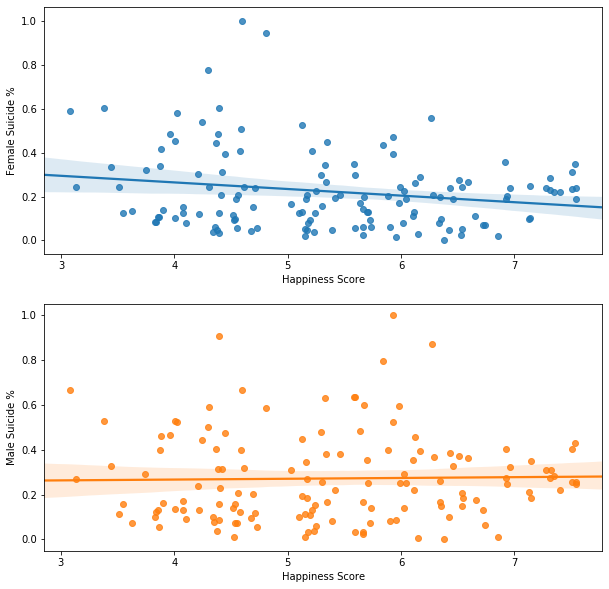

In [45]:
fig,(ax1,ax2)= plt.subplots(figsize=(10,10),nrows=2)

FemalePlot = sns.regplot(y=df_MergedDataSets['FS_scaled'], x=df_MergedDataSets['Happiness Score'], ax=ax1)
FemalePlot.set(ylabel="Female Suicide %")

MalePlot = sns.regplot(y=df_MergedDataSets['MS_scaled'], x=df_MergedDataSets['Happiness Score'], ax=ax2)
MalePlot.set(ylabel="Male Suicide %")

### Analyzing the relation and answering the question

As shown in the above graphs, as the happiness score increases, the females' suicide rate decreases. However, the males' suicide rate slightly increases. Thus, it means that there is an inverse relation between the happiness of the country and the females' suicidal rates.

## Question 2
### How does the increasing of green areas affect the happiness score of each country?

### Removing outliers

In [46]:
df_outliers = df_MergedDataSets
df_outliers['z_score_FC']=stats.zscore(df_MergedDataSets['Change forest %'])
df_outliers = df_outliers.loc[df_outliers['z_score_FC'].abs()<=5]

### Scaling to remove the negative values in order to start the scale with 0

In [47]:
FC_scaled = df_outliers[['z_score_FC']].values.astype(float)

min_max_scaler = preprocessing.MinMaxScaler()
df_outliers['FC_scaled'] = min_max_scaler.fit_transform(FC_scaled)

### Plotting the relation

[Text(0, 0.5, 'Global Forest Cover Change %')]

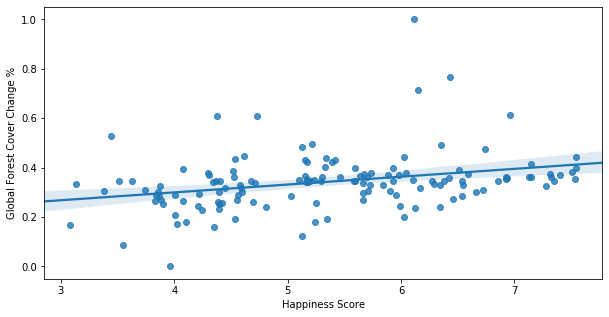

In [48]:
fig,(ax1)= plt.subplots(figsize=(10,5))
GreenAreaPlot = sns.regplot(y=df_outliers['FC_scaled'], x=df_outliers['Happiness Score'],ax=ax1)
GreenAreaPlot.set(ylabel="Global Forest Cover Change %")

### Analyzing the relation and answering the question

The Global Forest Cover Change is defined as the decreasing of the number of green areas throughout the years. As shown in the above Figure, as the number of the green areas decreases, the happiness of the country increases unexpectedly.

## Question 3
### What is the effect of the deaths of different ranges of ages on the happiness score?

In [49]:
df_all_merged['Adult Mortality']

0      269.0625
1       45.0625
2      108.1875
3      328.5625
4      106.0000
         ...   
134    119.9375
135    184.8125
136    211.8125
137    354.3125
138    462.3750
Name: Adult Mortality, Length: 139, dtype: float64

### Plotting the relation before

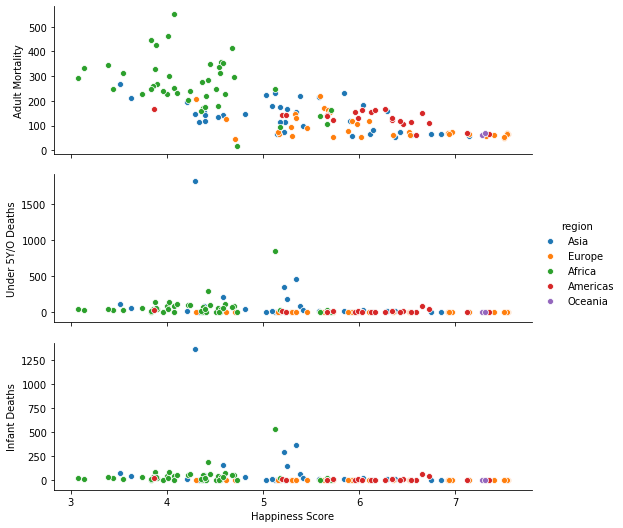

In [50]:
sns.pairplot(df_all_merged,
y_vars=['Adult Mortality', 'Under 5Y/O Deaths','Infant Deaths'],
x_vars=['Happiness Score'],aspect=3 ,hue='region')

### Remove the Outliers

In [51]:
df_outliers = df_all_merged
df_outliers['z_score_Ad']=stats.zscore(df_all_merged['Adult Mortality'])
df_outliers['z_score_UN5']=stats.zscore(df_all_merged['Under 5Y/O Deaths'])
df_outliers['z_score_Inf_D']=stats.zscore(df_all_merged['Infant Deaths'])
df_outliers = df_outliers.loc[df_outliers['z_score_Ad'].abs()<=5]
df_outliers = df_outliers.loc[df_outliers['z_score_UN5'].abs()<=5]
df_outliers = df_outliers.loc[df_outliers['z_score_Inf_D'].abs()<=5]

### Scaling of the data to have the same scale for all graphs

In [52]:
Ad_scaled = df_outliers[['Adult Mortality']].values.astype(float)
UN5_scaled = df_outliers[['Under 5Y/O Deaths']].values.astype(float)
Inf_D_scaled = df_outliers[['Infant Deaths']].values.astype(float)
min_max_scaler = preprocessing.MinMaxScaler()
df_outliers['Adult Mortality_N'] = min_max_scaler.fit_transform(Ad_scaled)
df_outliers['Under 5Y/O Deaths_N'] = min_max_scaler.fit_transform(UN5_scaled)
df_outliers['Infant Deaths_N'] = min_max_scaler.fit_transform(Inf_D_scaled)

### Plotting the relation after further cleaning

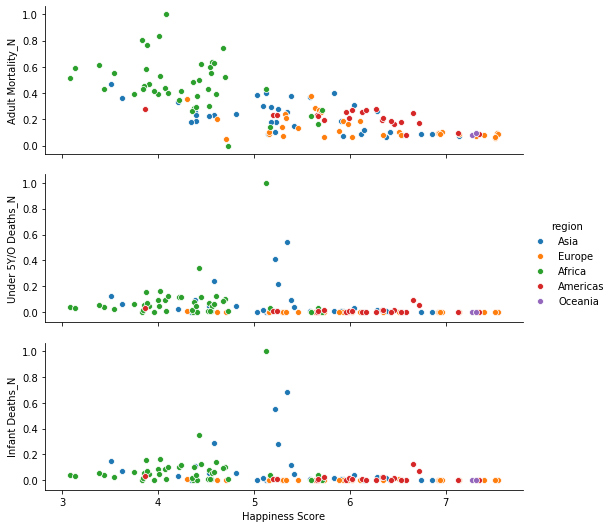

In [53]:
sns.pairplot(df_outliers,
y_vars=['Adult Mortality_N', 'Under 5Y/O Deaths_N','Infant Deaths_N'],
x_vars=['Happiness Score'],aspect=3 ,hue='region')

In [54]:
df_outliers.cov()['Happiness Score']['Adult Mortality_N': 'Infant Deaths_N']

Adult Mortality_N     -0.152685
Under 5Y/O Deaths_N   -0.027087
Infant Deaths_N       -0.027887
Name: Happiness Score, dtype: float64

### Analyzing the relation and answering the question

As shown in the previous Graphs the Adult Deaths affect the Happiness Score of The Countries more than the under 5 years and infant Deaths (which approximetly didn't affect the Happiness Score) 

### Feature Engineering (interaction) 
Where the Adult Mortality , Under 5Y/O Deaths and  Infant Deaths are calculated for 1000 so to calculate for the whole Population we multiplied by 1000 and divided by population

In [55]:
population = df_all_merged['Population'].values.astype(float)
percentage = 1000/population
df_all_merged['Adult Mortality per Population']  = df_all_merged['Adult Mortality'].values.astype(float)*percentage

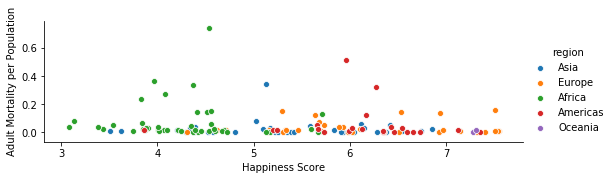

In [56]:
sns.pairplot(df_all_merged,
y_vars=['Adult Mortality per Population'],
x_vars=['Happiness Score'],aspect=3 ,hue='region')

## Question 4
### What is the effect of literacy rate on crime types?

### Plotting the relation before

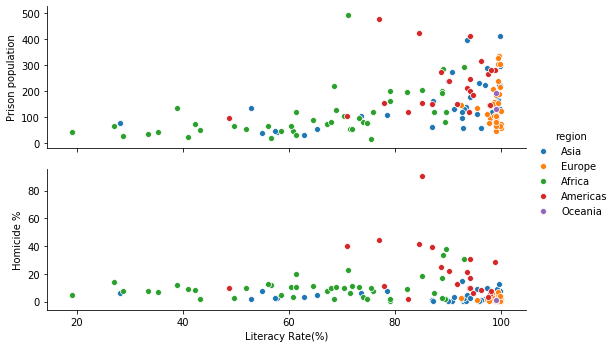

In [57]:
sns.pairplot(df_all_merged,
y_vars=['Prison population', 'Homicide %'],
x_vars=['Literacy Rate(%)'],aspect=3 ,hue='region')


### Removing the outliers

In [58]:
df_outliers_1 = df_all_merged
df_outliers_1['z_score_PP']=stats.zscore(df_all_merged['Prison population'])
df_outliers_1['z_score_H']=stats.zscore(df_all_merged['Homicide %'])
df_outliers_1 = df_outliers_1.loc[df_outliers_1['z_score_PP'].abs()<=5]
df_outliers_1 = df_outliers_1.loc[df_outliers_1['z_score_H'].abs()<=5]

### Scaling of the data to have the same scale for all graphs

In [59]:
PP_scaled = df_outliers_1[['Prison population']].values.astype(float)
H_scaled = df_outliers_1[['Homicide %']].values.astype(float)
min_max_scaler = preprocessing.MinMaxScaler()
df_outliers_1['Prison population_N'] = min_max_scaler.fit_transform(PP_scaled)
df_outliers_1['Homicide_N'] = min_max_scaler.fit_transform(H_scaled)

### Plotting the relation after further cleaning

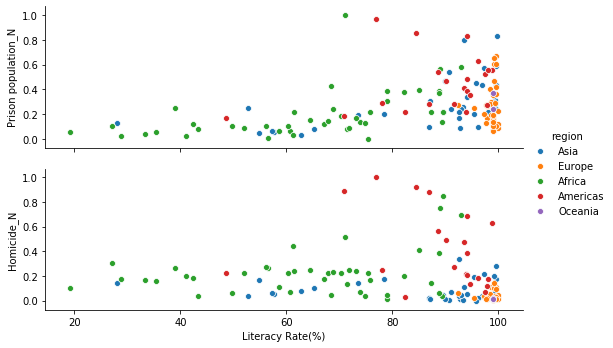

In [60]:
sns.pairplot(df_outliers_1,
y_vars=['Prison population_N', 'Homicide_N'],
x_vars=['Literacy Rate(%)'],aspect=3 ,hue='region')

In [61]:
df_outliers_1.cov()['Literacy Rate(%)']['Prison population_N': 'Homicide_N']

Prison population_N    1.705960
Homicide_N            -0.600591
Name: Literacy Rate(%), dtype: float64

[Text(0.5, 0, 'Literacy Rate(%)')]

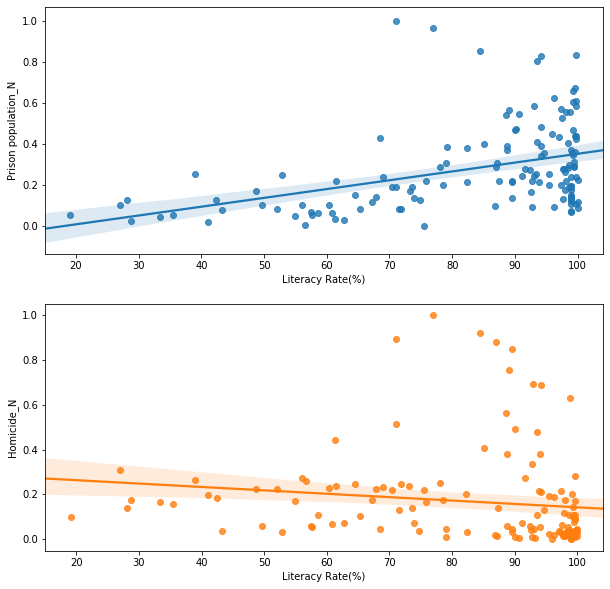

In [62]:
fig,(ax1,ax2)= plt.subplots(figsize=(10,10),nrows=2)

regplot_prison_population = sns.regplot(x=df_outliers_1['Literacy Rate(%)'], y=df_outliers_1['Prison population_N'], ax=ax1)
regplot_prison_population.set(xlabel="Literacy Rate(%)")

regplot_Homicide_population = sns.regplot(x=df_outliers_1['Literacy Rate(%)'], y=df_outliers_1['Homicide_N'], ax=ax2)
regplot_Homicide_population.set(xlabel="Literacy Rate(%)")

### Analyzing the relation and answering the question

As shown in the previous Graphs the increasing of Literacy Rate leads to the increase in the number of Prison population (number of crimes) but the Homicide Crimes are decreasing so the Literacy Rate affect the type of the crimes.

Beside Note: When the Literacy Rate increases (becomes in 90% - 100%) the Homicide highly decreases and form a cluster (apporches to zero) which is not the case in the number of crimes

## Question 5
### Is the spread of diseases affected by the prison population?

### Scaling of the data to have the same scale for both graphs

In [63]:
HB_scaled = df_MergedDataSets[['Hepatitis B']].values.astype(float)
AIDS_scaled = df_MergedDataSets[['HIV/AIDS']].values.astype(float)

min_max_scaler = preprocessing.MinMaxScaler()
df_MergedDataSets['HB_scaled'] = min_max_scaler.fit_transform(HB_scaled)
df_MergedDataSets['AIDS_scaled'] = min_max_scaler.fit_transform(AIDS_scaled)

### Plotting the relation

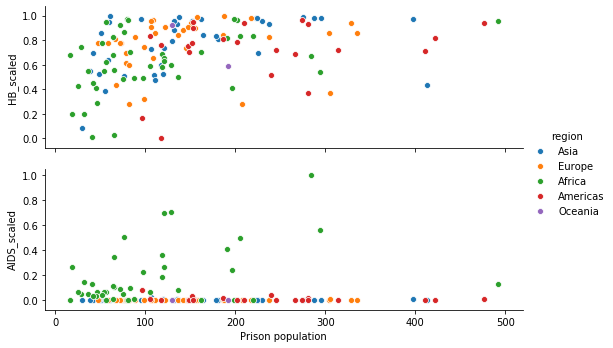

In [64]:
sns.pairplot(df_MergedDataSets,
            y_vars=['HB_scaled', 'AIDS_scaled'],
            x_vars=[ 'Prison population'],aspect=3,hue='region')


### Analyzing the relation and answering the question

The spread of Heptatitis B is proportionally affected with the Prison population. That means as the prison population increases the occurence of Heptatitis B also increases. However, HIV/AIDS  is not affected by the prison population.

## Question 6
### Is freedom really needed in a country?

### Plotting the relation

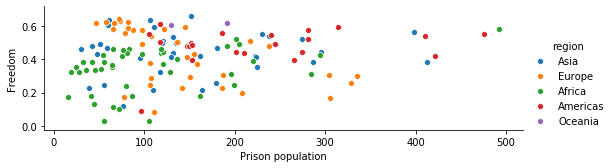

In [65]:
sns.pairplot(df_MergedDataSets,
            y_vars=['Freedom'],
            x_vars=[ 'Prison population'],aspect=3,hue='region')

### Analyzing the relation and answering the question

As showed above, as the freedom increases in a country, the number of commited crimes, i.e., prison population, increases.

## Question 7
### What is the effect of human overpopulation on many aspects in the countries?

### Creating new columns (Feature Engineering)

Interaction feature engineering by calculating total suicide rate and density of each country from population and area. The total suicidal rate is calculated to represent the total suicidal rates in each country per the density of the country. While, density is calculated to visualize the relation between over-population and many factors as shown in the Figures below.

In [66]:
df_all_merged['Suicide %'] = df_all_merged['FemaleSuicide %'] + df_all_merged['MaleSuicide %']

area_col = df_all_merged[['area']].values.astype(float)
pop_col = df_all_merged[['Population']].values.astype(float)
density = pop_col/area_col
df_all_merged['Density'] = density

df_all_merged= df_all_merged[df_all_merged['Density']<100]

### Plotting the relation

[Text(0.5, 0, "Country's Density")]

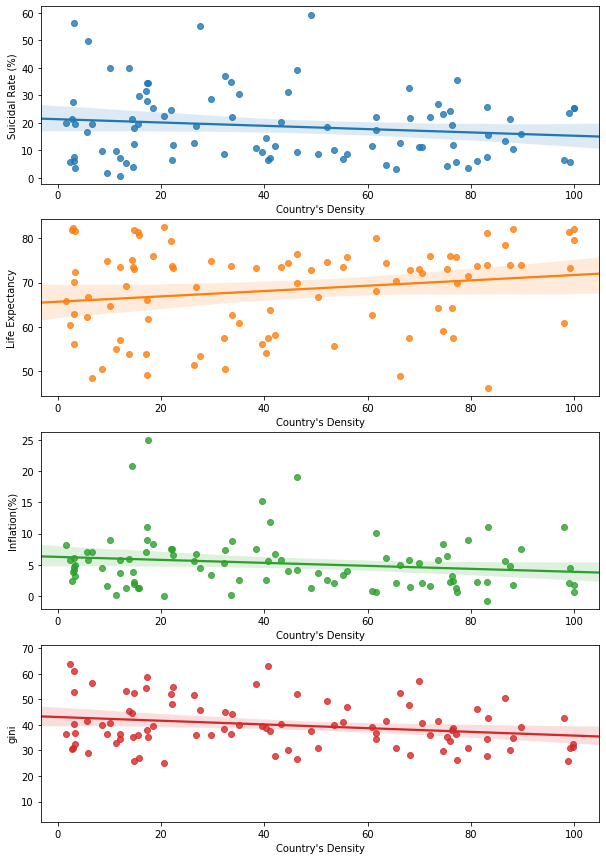

In [67]:
fig,(ax1,ax2,ax3,ax4)= plt.subplots(figsize=(10,15),nrows=4)

regplot_suicide_density = sns.regplot(x=df_all_merged['Density'], y=df_all_merged['Suicide %'],ax=ax1)
regplot_suicide_density.set(xlabel="Country's Density")
regplot_suicide_density.set(ylabel="Suicidal Rate (%)")

regplot_health_density = sns.regplot(x=df_all_merged['Density'], y=df_all_merged['Life Expectancy'],ax=ax2)
regplot_health_density.set(xlabel="Country's Density")

regplot_health_density = sns.regplot(x=df_all_merged['Density'], y=df_all_merged['Inflation(%)'],ax=ax3)
regplot_health_density.set(xlabel="Country's Density")

regplot_exp_density = sns.regplot(x=df_all_merged['Density'], y=df_all_merged['gini'],ax=ax4)
regplot_exp_density.set(xlabel="Country's Density")

### Analyzing the relation and answering the question

As shown in the above graphs, as the density of the country increases, the suicidal rate decreases. As the density of the country increases, life expectancy increases. While, as the density increases, inflation slightly decreases. Last but not least, as the density of the country increases, gini decreases.

# Exploring the Datasets

## Exploring Happiness and 250 Country

In [68]:
df_happiness_250_explore = pd.merge(df_happiness, df_250Country, on='name')
df_happiness_250_explore

,Dystopia Residual,Family,Freedom,GDP,Generosity,Happiness Rank,Happiness Score,Health,Trust,name,region,subregion,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%)
0,2.047296,0.409753,0.117924,0.357113,0.267730,149.4,3.51280,0.254707,0.058094,Afghanistan,Asia,Southern Asia,27657145,652230.0,27.8,3.1,28.1,6.8,35.0
1,1.648508,0.754931,0.371898,0.938633,0.167887,106.4,4.71260,0.787696,0.043201,Albania,Europe,Southern Europe,2886026,28748.0,34.5,0.7,98.7,1.7,16.9
2,2.521547,1.074205,0.178437,1.012963,0.069219,66.2,5.66760,0.665057,0.146099,Algeria,Africa,Northern Africa,40400000,2381741.0,35.3,3.1,79.0,3.9,10.3
3,1.797366,0.938368,0.027433,0.798380,0.105269,140.0,3.87225,0.133902,0.071570,Angola,Africa,Middle Africa,25868000,1246700.0,58.6,5.6,70.4,8.9,NaN
4,2.618171,1.330960,0.481620,1.111035,0.092371,31.2,6.45940,0.760895,0.064308,Argentina,Americas,South America,43590400,2780400.0,44.5,3.5,97.9,20.8,7.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,2.264844,1.315312,0.574978,1.135558,0.169011,30.6,6.43120,0.782929,0.188516,Uruguay,Americas,South America,3480222,181034.0,39.7,3.5,98.1,8.3,6.5
140,2.045741,1.434100,0.655988,0.723758,0.327523,45.0,6.04620,0.591725,0.267424,Uzbekistan,Asia,Central Asia,31576400,447400.0,36.7,7.0,99.4,10.1,4.9
141,1.497336,0.865448,0.244175,0.489313,0.096929,146.4,3.62580,0.365440,0.067045,Yemen,Asia,Western Asia,27478000,527968.0,37.7,3.8,65.3,11.8,35.0
142,1.999583,0.932381,0.462099,0.571761,0.218430,114.0,4.58440,0.302761,0.097337,Zambia,Africa,Eastern Africa,15933883,752612.0,54.6,6.0,61.4,7.1,15.0


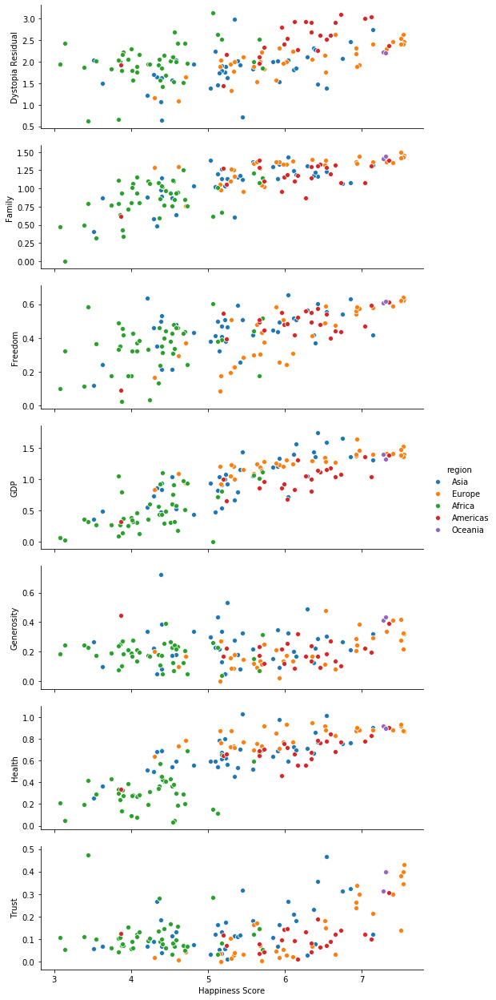

In [69]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Dystopia Residual', 'Family','Freedom','GDP','Generosity','Health','Trust'],
x_vars=['Happiness Score'],aspect=3 ,hue='region')

In [70]:
df_happiness_250_explore.cov()

,Dystopia Residual,Family,Freedom,GDP,Generosity,Happiness Rank,Happiness Score,Health,Trust,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%)
Dystopia Residual,2.358882e-01,3.275703e-03,8.974574e-03,6.879272e-03,-2.912192e-03,-1.053699e+01,2.594440e-01,0.005995,1.321049e-03,-2.976648e+06,8.709881e+04,0.021671,-2.163400e-01,-4.846092e-01,-1.489805e-01,-1.081177e+00
Family,3.275703e-03,7.956179e-02,1.803196e-02,8.481863e-02,3.193509e-03,-9.536338e+00,2.405764e-01,0.045383,6.316955e-03,-5.121955e+06,4.044117e+04,-0.490384,-3.159459e-02,4.082123e+00,-3.301991e-01,-1.266886e+00
Freedom,8.974574e-03,1.803196e-02,2.128994e-02,2.412596e-02,6.189245e-03,-3.982935e+00,1.011301e-01,0.014769,7.689290e-03,1.061377e+06,1.538814e+04,0.013721,1.047511e-02,1.109804e+00,-1.599483e-01,-7.832601e-01
GDP,6.879272e-03,8.481863e-02,2.412596e-02,1.706953e-01,-8.924973e-04,-1.552294e+01,3.849668e-01,0.084807,1.416323e-02,-1.640988e+06,4.271916e+04,-0.945899,-3.873907e-01,6.594849e+00,-7.043053e-01,-2.808103e+00
Generosity,-2.912192e-03,3.193509e-03,6.189245e-03,-8.924973e-04,1.274257e-02,-8.106876e-01,2.347606e-02,0.001635,3.491978e-03,-1.139851e+06,-6.142326e+02,-0.090359,-6.593504e-04,-6.750637e-02,3.675946e-04,-2.564876e-01
Happiness Rank,-1.053699e+01,-9.536338e+00,-3.982935e+00,-1.552294e+01,-8.106876e-01,2.069796e+03,-5.122083e+01,-8.865570,-1.937129e+00,4.667136e+08,-7.974884e+06,87.439689,3.426610e+01,-6.223363e+02,7.414339e+01,3.374523e+02
Happiness Score,2.594440e-01,2.405764e-01,1.011301e-01,3.849668e-01,2.347606e-02,-5.122083e+01,1.282211e+00,0.220260,5.168213e-02,-1.103417e+07,2.140998e+05,-2.461403,-8.449383e-01,1.534666e+01,-1.860233e+00,-8.169341e+00
Health,5.995284e-03,4.538256e-02,1.476887e-02,8.480743e-02,1.635400e-03,-8.865570e+00,2.202596e-01,0.059997,7.599930e-03,4.134251e+05,2.181338e+04,-0.820533,-1.981441e-01,3.802671e+00,-4.353212e-01,-1.671220e+00
Trust,1.321049e-03,6.316955e-03,7.689290e-03,1.416323e-02,3.491978e-03,-1.937129e+00,5.168213e-02,0.007600,1.100869e-02,-1.611283e+06,7.563409e+03,-0.149692,-2.123812e-02,3.052077e-01,-7.975897e-02,-2.941797e-01
population,-2.976648e+06,-5.121955e+06,1.061377e+06,-1.640988e+06,-1.139851e+06,4.667136e+08,-1.103417e+07,413425.129375,-1.611283e+06,2.543980e+16,1.277110e+14,501142.194657,-5.127166e+06,-2.445505e+08,7.765282e+07,-1.461758e+08


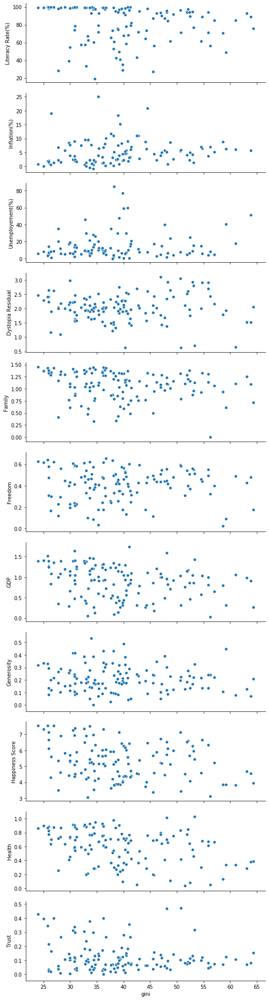

In [71]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Literacy Rate(%)', 'Inflation(%)', 'Unemployement(%)',
       'Dystopia Residual', 'Family', 'Freedom', 'GDP', 'Generosity',
       'Happiness Score', 'Health', 'Trust'],
x_vars=["gini"],aspect=3) 

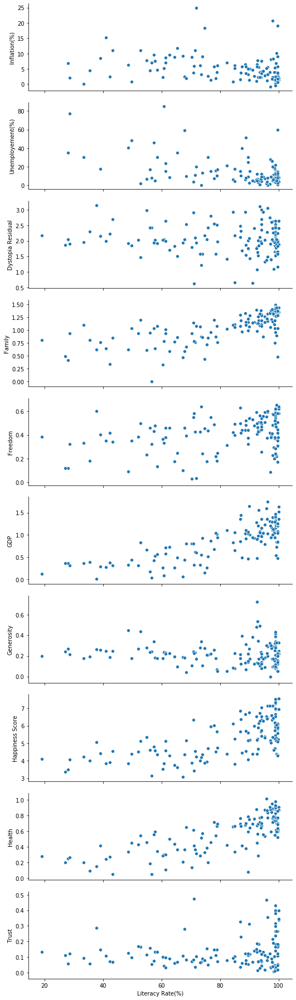

In [72]:
sns.pairplot(df_happiness_250_explore,
y_vars=[ 'Inflation(%)', 'Unemployement(%)',
       'Dystopia Residual', 'Family', 'Freedom', 'GDP', 'Generosity',
       'Happiness Score', 'Health', 'Trust'],
x_vars=['Literacy Rate(%)'],aspect=3)

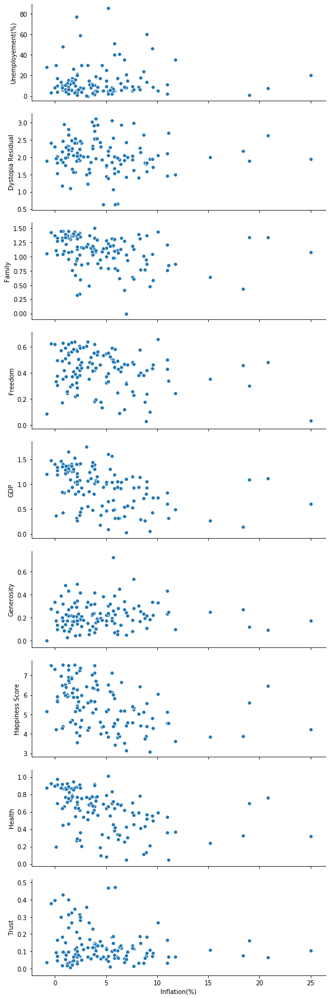

In [73]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Unemployement(%)','Dystopia Residual', 'Family', 'Freedom', 
        'GDP', 'Generosity', 'Happiness Score', 'Health', 'Trust'],
x_vars=['Inflation(%)'],aspect=3)

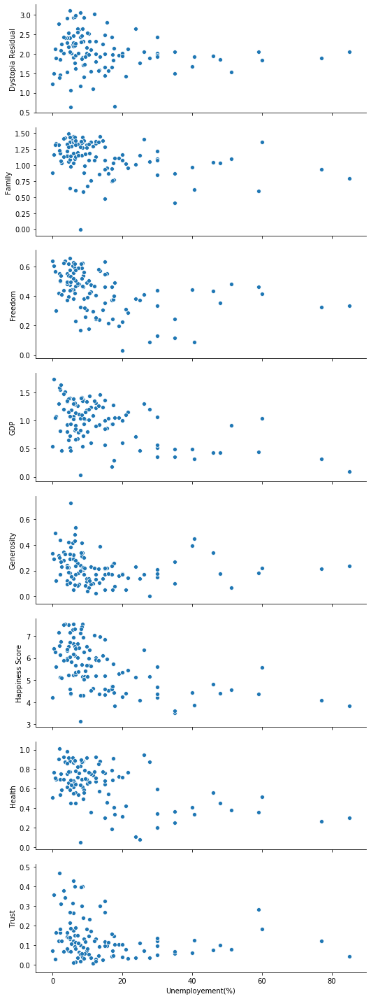

In [74]:
sns.pairplot(df_happiness_250_explore,
y_vars=[ 'Dystopia Residual', 'Family', 'Freedom', 'GDP', 'Generosity',
       'Happiness Score', 'Health', 'Trust'],
x_vars=[ 'Unemployement(%)'],aspect=3)

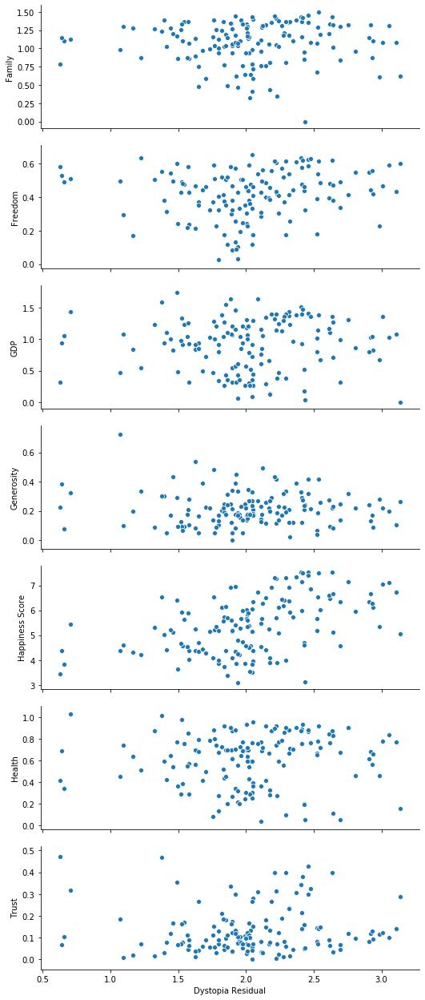

In [75]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Family', 'Freedom', 'GDP', 'Generosity',
       'Happiness Score', 'Health', 'Trust'],
x_vars=['Dystopia Residual'],aspect=3)

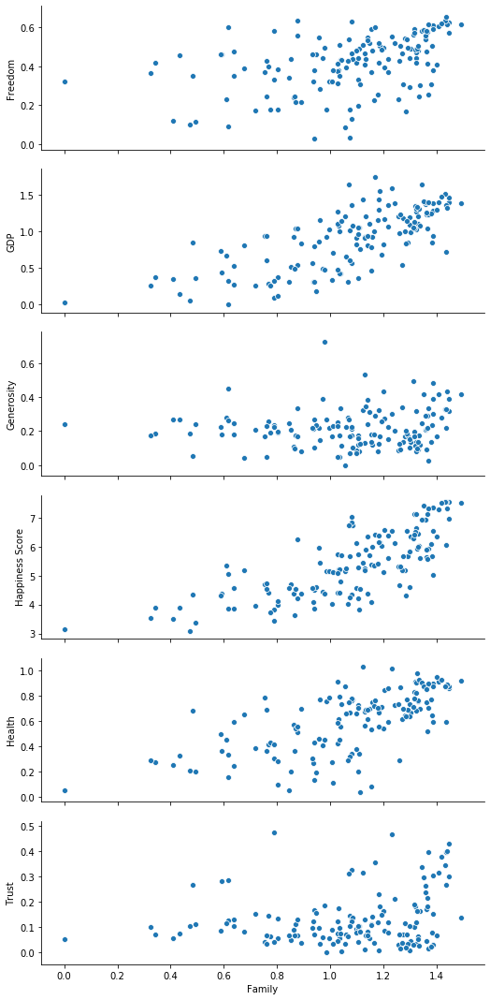

In [76]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Freedom', 'GDP', 'Generosity',
       'Happiness Score', 'Health', 'Trust'],
x_vars=['Family'],aspect=3)

Family is positively increasing with all factors 

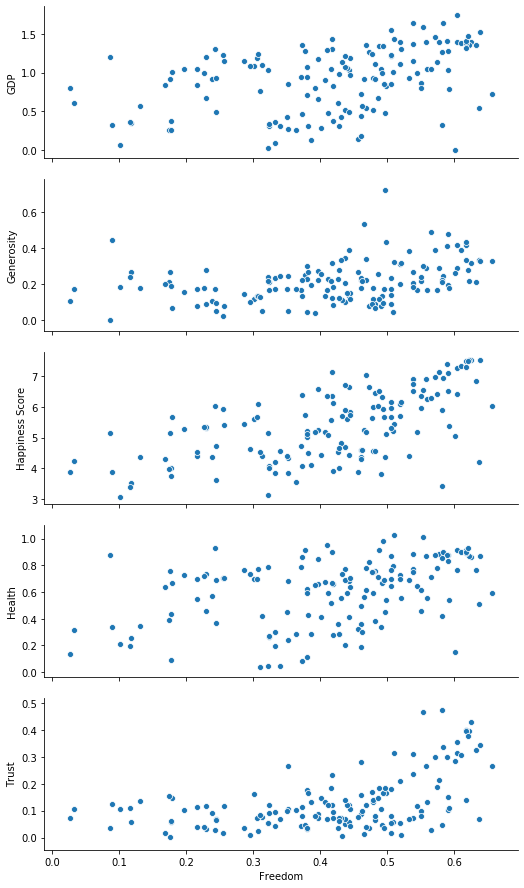

In [77]:
sns.pairplot(df_happiness_250_explore,
y_vars=['GDP', 'Generosity', 'Happiness Score', 'Health', 'Trust'],
x_vars=['Freedom'],aspect=3)

Freedom is positively increasing with all factors 

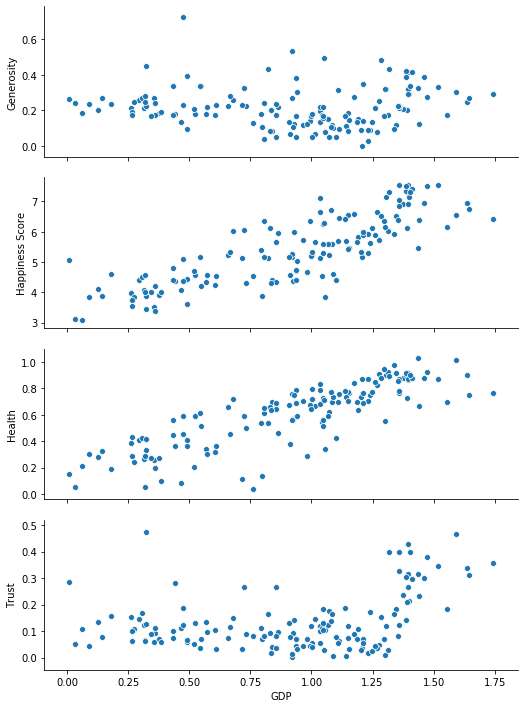

In [78]:
sns.pairplot(df_happiness_250_explore,
y_vars=['Generosity', 'Happiness Score', 'Health', 'Trust'],
x_vars=['GDP'],aspect=3)

GDP is affecting the Health and Happiness Score positively 

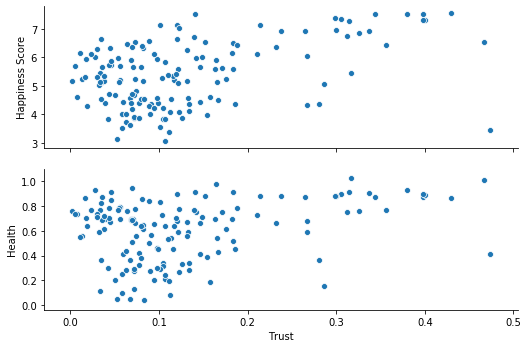

In [79]:
sns.pairplot(df_happiness_250_explore, 
y_vars=['Happiness Score', 'Health'],
x_vars=['Trust'],aspect=3)

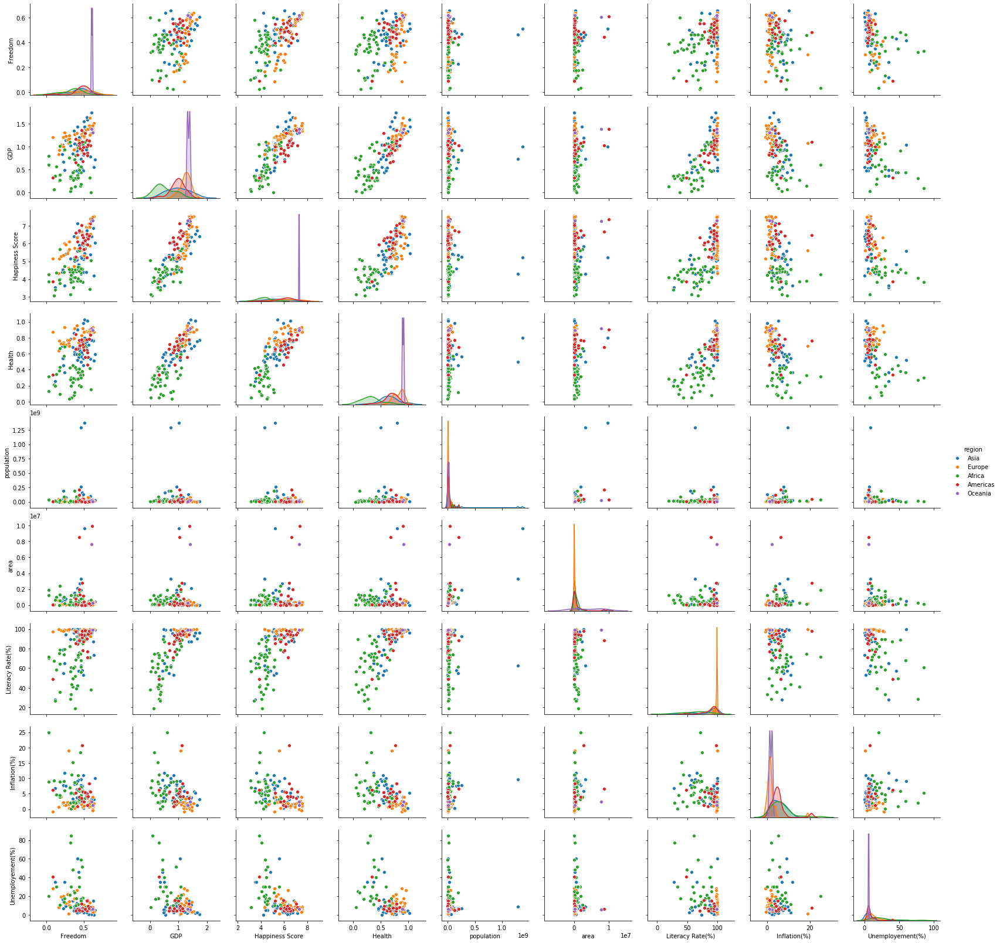

In [80]:
sns.pairplot(df_happiness_250_explore.drop(["gini", "Happiness Rank","Real Growth Rating(%)","Trust", "Dystopia Residual","Family","Generosity"], axis=1),hue="region")

## Exploring Life Expentancey and 250 Country


In [81]:
df_250_lifeExpectancy_explore = pd.merge(df_250Country, df_life_expectancy_cleaned, on='name')
df_250_lifeExpectancy_explore

,name,region,subregion,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%),...,Polio,Total Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness in 10-19 years,Thinness in 5-9 years,Income composition of resources,Schooling
0,Afghanistan,Asia,Southern Asia,27657145,652230.0,27.8,3.1,28.1,6.8,35.0,...,48.3750,8.252500,52.3125,0.10000,380.473148,2.745116e+07,16.58125,15.58125,0.415375,8.21250
1,Albania,Europe,Southern Europe,2886026,28748.0,34.5,0.7,98.7,1.7,16.9,...,98.1250,5.945625,98.0625,0.10000,3218.939465,2.968698e+06,1.61875,1.70000,0.709875,12.13750
2,Algeria,Africa,Northern Africa,40400000,2381741.0,35.3,3.1,79.0,3.9,10.3,...,91.7500,4.604000,91.8750,0.10000,3753.086728,3.482137e+07,6.09375,5.97500,0.694875,12.71250
3,Angola,Africa,Middle Africa,25868000,1246700.0,58.6,5.6,70.4,8.9,NaN,...,46.1250,3.919333,47.6875,2.36875,2947.288504,2.162286e+07,6.19375,6.66875,0.458375,8.04375
4,Antigua and Barbuda,Americas,Caribbean,86295,442.0,NaN,1.7,99.0,3.0,11.0,...,96.9375,4.791333,98.3125,0.12500,12873.731407,8.480194e+04,3.42500,3.37500,0.488625,8.84375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181,Venezuela (Bolivarian Republic of),Americas,South America,31028700,916445.0,44.8,NaN,NaN,NaN,NaN,...,74.6875,4.998667,68.5000,0.10000,8759.732396,2.739287e+07,1.65000,1.56250,0.726812,12.78750
182,Viet Nam,Asia,South-Eastern Asia,92700000,331212.0,35.6,NaN,NaN,NaN,NaN,...,94.9375,5.977333,91.7500,0.14375,1098.591020,8.603401e+07,14.92500,15.62500,0.627063,11.51250
183,Yemen,Asia,Western Asia,27478000,527968.0,37.7,3.8,65.3,11.8,35.0,...,67.1250,5.005333,72.6250,0.10000,1060.223567,2.173041e+07,13.83125,13.75000,0.475500,8.50625
184,Zambia,Africa,Eastern Africa,15933883,752612.0,54.6,6.0,61.4,7.1,15.0,...,64.3750,5.824000,74.2500,11.93125,1088.686392,1.286147e+07,6.88125,6.76250,0.498437,11.21250


In [82]:
df_250_lifeExpectancy_explore.cov()

,population,area,gini,Real Growth Rating(%),Literacy Rate(%),Inflation(%),Unemployement(%),Life Expectancy,Adult Mortality,Infant Deaths,...,Polio,Total Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness in 10-19 years,Thinness in 5-9 years,Income composition of resources,Schooling
population,2.048613e+16,1.265679e+14,-8.579315e+06,-6.263095e+04,-2.341367e+08,-3.709306e+08,-1.455286e+08,2.390513e+07,-1.024332e+09,1.256161e+10,...,-4.297535e+07,-1.681407e+07,-2.354432e+07,-3.127767e+07,-1.446098e+11,1.948818e+16,1.764869e+08,1.823569e+08,-274445.459668,-2.141404e+07
area,1.265679e+14,3.809452e+12,7.721139e+05,-5.531059e+04,-9.542957e+05,-5.986476e+06,-1.378557e+06,1.145952e+06,-8.620764e+06,4.099433e+07,...,1.621880e+06,4.817827e+05,2.575367e+06,-4.234833e+05,1.662795e+09,1.213081e+14,-3.055755e+05,-3.309418e+05,37801.943625,6.410015e+05
gini,-8.579315e+06,7.721139e+05,8.623283e+01,8.294225e+00,-2.060202e+01,5.071886e+00,9.021159e+00,-2.857924e+01,3.254368e+02,-4.827072e+01,...,-3.158694e+01,-1.331309e+00,-2.351736e+01,1.623715e+01,-5.021818e+04,-8.545414e+06,2.345346e+00,2.768015e+00,-0.478665,-7.220819e+00
Real Growth Rating(%),-6.263095e+04,-5.531059e+04,8.294225e+00,2.175927e+01,-1.277350e+01,2.490681e+00,3.894188e+00,-8.163947e+00,7.454055e+01,2.260498e+01,...,-4.198583e+00,-1.423803e+00,-5.137976e-01,4.217920e-01,-2.306233e+04,-2.113979e+06,2.332818e+00,2.476390e+00,-0.189167,-3.059448e+00
Literacy Rate(%),-2.341367e+08,-9.542957e+05,-2.060202e+01,-1.277350e+01,3.909818e+02,-2.095972e+01,-1.131403e+02,1.378641e+02,-1.026298e+03,-5.929027e+02,...,2.189341e+02,9.140539e+00,2.151928e+02,-1.552688e+01,1.625022e+05,-1.969431e+08,-4.904426e+01,-4.724512e+01,2.839261,4.938044e+01
Inflation(%),-3.709306e+08,-5.986476e+06,5.071886e+00,2.490681e+00,-2.095972e+01,2.777696e+04,1.187511e+03,-1.618886e+01,1.676638e+02,-3.241565e+02,...,5.824452e+01,-1.869038e+01,5.564223e+01,-1.650090e+01,-6.953515e+04,-3.369211e+08,-6.185003e+01,-6.247467e+01,-0.297225,-3.715753e+01
Unemployement(%),-1.455286e+08,-1.378557e+06,9.021159e+00,3.894188e+00,-1.131403e+02,1.187511e+03,2.610999e+02,-5.700569e+01,4.815931e+02,-1.356183e+01,...,-7.017263e+01,2.281857e+00,-7.253206e+01,1.253952e+01,-8.710697e+04,-1.386933e+08,1.379022e+01,1.261304e+01,-1.256344,-2.235132e+01
Life Expectancy,2.390513e+07,1.145952e+06,-2.857924e+01,-8.163947e+00,1.378641e+02,-1.618886e+01,-5.700569e+01,8.453048e+01,-7.930322e+02,-1.967472e+02,...,1.001641e+02,4.923048e+00,1.005340e+02,-2.429670e+01,9.145233e+04,3.196094e+07,-1.956173e+01,-1.966585e+01,1.367423,2.254165e+01
Adult Mortality,-1.024332e+09,-8.620764e+06,3.254368e+02,7.454055e+01,-1.026298e+03,1.676638e+02,4.815931e+02,-7.930322e+02,9.284428e+03,9.434468e+02,...,-8.175795e+02,-3.290150e+01,-7.906948e+02,3.033508e+02,-8.021521e+05,-1.030783e+09,1.596902e+02,1.642876e+02,-11.458097,-1.797536e+02
Infant Deaths,1.256161e+10,4.099433e+07,-4.827072e+01,2.260498e+01,-5.929027e+02,-3.241565e+02,-1.356183e+01,-1.967472e+02,9.434468e+02,1.301218e+04,...,-4.032949e+02,-3.626570e+01,-4.016478e+02,1.176012e+01,-2.833205e+05,1.168835e+10,2.419566e+02,2.487740e+02,-3.536152,-6.873017e+01


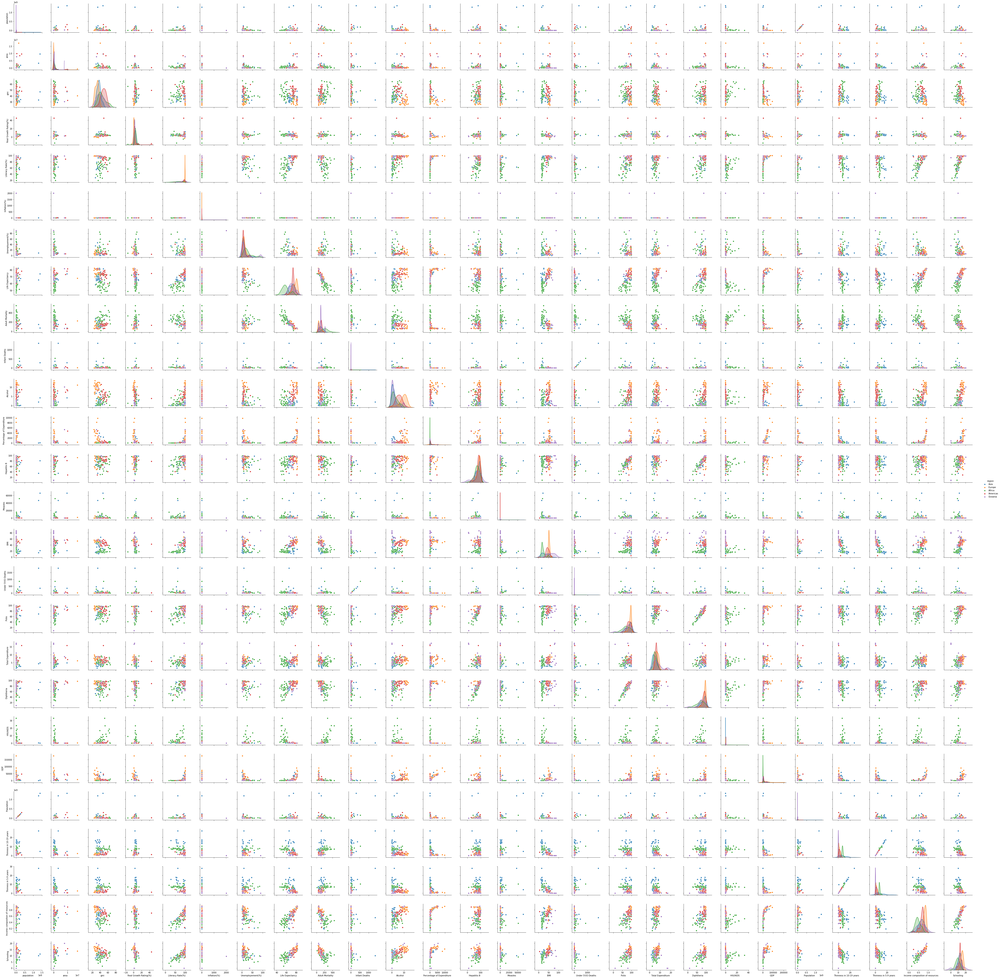

In [83]:
sns.pairplot(df_250_lifeExpectancy_explore,hue='region')

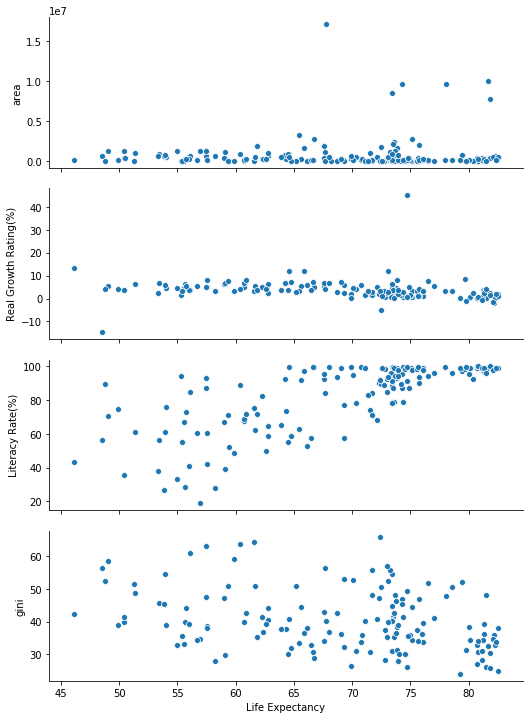

In [84]:
sns.pairplot(df_250_lifeExpectancy_explore,
y_vars=['area', 'Real Growth Rating(%)', 'Literacy Rate(%)', 'gini'],
x_vars=['Life Expectancy'],aspect=3)

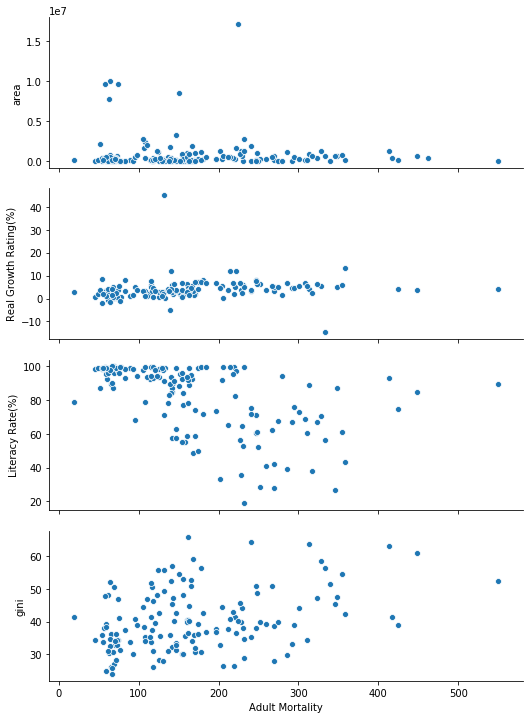

In [85]:
sns.pairplot(df_250_lifeExpectancy_explore,
y_vars=['area', 'Real Growth Rating(%)', 'Literacy Rate(%)', 'gini'],
x_vars=['Adult Mortality'],aspect=3)

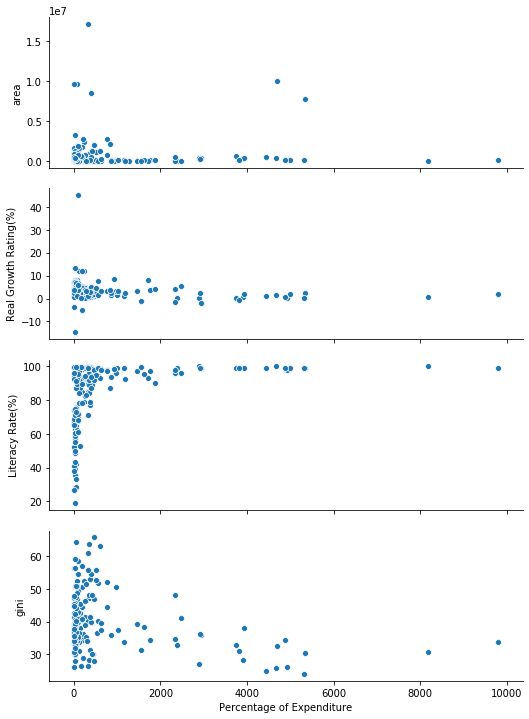

In [86]:
sns.pairplot(df_250_lifeExpectancy_explore,
y_vars=['area', 'Real Growth Rating(%)', 'Literacy Rate(%)', 'gini'],
x_vars=['Percentage of Expenditure'],aspect=3)

## Exploring Life Expentancy and Happiness

In [87]:
df_happiness_lifeExpectancy_explore = pd.merge(df_happiness, df_life_expectancy_cleaned, on='name')
df_happiness_lifeExpectancy_explore

,Dystopia Residual,Family,Freedom,GDP_x,Generosity,Happiness Rank,Happiness Score,Health,Trust,name,...,Polio,Total Expenditure,Diphtheria,HIV/AIDS,GDP_y,Population,Thinness in 10-19 years,Thinness in 5-9 years,Income composition of resources,Schooling
0,2.047296,0.409753,0.117924,0.357113,0.267730,149.4,3.51280,0.254707,0.058094,Afghanistan,...,48.3750,8.252500,52.3125,0.10000,380.473148,2.745116e+07,16.58125,15.58125,0.415375,8.21250
1,1.648508,0.754931,0.371898,0.938633,0.167887,106.4,4.71260,0.787696,0.043201,Albania,...,98.1250,5.945625,98.0625,0.10000,3218.939465,2.968698e+06,1.61875,1.70000,0.709875,12.13750
2,2.521547,1.074205,0.178437,1.012963,0.069219,66.2,5.66760,0.665057,0.146099,Algeria,...,91.7500,4.604000,91.8750,0.10000,3753.086728,3.482137e+07,6.09375,5.97500,0.694875,12.71250
3,1.797366,0.938368,0.027433,0.798380,0.105269,140.0,3.87225,0.133902,0.071570,Angola,...,46.1250,3.919333,47.6875,2.36875,2947.288504,2.162286e+07,6.19375,6.66875,0.458375,8.04375
4,2.618171,1.330960,0.481620,1.111035,0.092371,31.2,6.45940,0.760895,0.064308,Argentina,...,93.3750,6.912667,92.3750,0.10000,8511.208281,3.991411e+07,1.07500,0.95000,0.794125,16.50625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135,2.264844,1.315312,0.574978,1.135558,0.169011,30.6,6.43120,0.782929,0.188516,Uruguay,...,94.2500,8.750000,89.1250,0.10000,9531.195910,3.349644e+06,1.60000,1.54375,0.765625,15.23125
136,2.045741,1.434100,0.655988,0.723758,0.327523,45.0,6.04620,0.591725,0.267424,Uzbekistan,...,98.5625,5.638000,98.4375,0.20625,1229.574795,2.755552e+07,3.14375,3.17500,0.603000,11.64375
137,1.497336,0.865448,0.244175,0.489313,0.096929,146.4,3.62580,0.365440,0.067045,Yemen,...,67.1250,5.005333,72.6250,0.10000,1060.223567,2.173041e+07,13.83125,13.75000,0.475500,8.50625
138,1.999583,0.932381,0.462099,0.571761,0.218430,114.0,4.58440,0.302761,0.097337,Zambia,...,64.3750,5.824000,74.2500,11.93125,1088.686392,1.286147e+07,6.88125,6.76250,0.498437,11.21250


In [88]:
df_happiness_lifeExpectancy_explore.cov()

,Dystopia Residual,Family,Freedom,GDP_x,Generosity,Happiness Rank,Happiness Score,Health,Trust,Life Expectancy,...,Polio,Total Expenditure,Diphtheria,HIV/AIDS,GDP_y,Population,Thinness in 10-19 years,Thinness in 5-9 years,Income composition of resources,Schooling
Dystopia Residual,2.201026e-01,2.447150e-03,9.592632e-03,0.006585,-1.424198e-03,-1.010988e+01,2.485984e-01,0.007575,3.696334e-03,5.199298e-01,...,-5.305464e-01,1.481172e-01,-5.010068e-01,-3.572115e-01,8.903401e+02,-3.009260e+06,-4.752704e-01,-5.063681e-01,0.009028,1.269693e-01
Family,2.447150e-03,8.123726e-02,1.845778e-02,0.085946,3.478330e-03,-9.659408e+00,2.440759e-01,0.045855,6.656967e-03,1.792728e+00,...,2.651669e+00,1.496795e-01,2.624664e+00,-2.719701e-01,2.519469e+03,-4.559827e+06,-6.625629e-01,-6.498734e-01,0.036731,6.778469e-01
Freedom,9.592632e-03,1.845778e-02,2.178304e-02,0.024293,6.349648e-03,-4.064137e+00,1.031793e-01,0.014829,7.811863e-03,5.562347e-01,...,8.727170e-01,1.886885e-02,8.634987e-01,-6.147728e-02,1.149768e+03,1.132298e+06,-1.155769e-01,-1.032955e-01,0.012249,2.173168e-01
GDP_x,6.585272e-03,8.594614e-02,2.429254e-02,0.169782,-1.037859e-03,-1.545285e+01,3.838875e-01,0.083632,1.430055e-02,3.365391e+00,...,4.427576e+00,1.005868e-01,4.373233e+00,-6.732047e-01,5.082970e+03,-8.461053e+05,-9.223158e-01,-9.192650e-01,0.067467,1.102013e+00
Generosity,-1.424198e-03,3.478330e-03,6.349648e-03,-0.001038,1.289166e-02,-8.770078e-01,2.518052e-02,0.001537,3.357140e-03,4.875060e-02,...,-1.566690e-01,-1.663805e-02,-2.236925e-01,-6.306537e-02,4.265503e+02,-1.143217e+06,6.917347e-02,6.982769e-02,-0.000439,5.705376e-03
Happiness Rank,-1.010988e+01,-9.659408e+00,-4.064137e+00,-15.452848,-8.770078e-01,2.062221e+03,-5.108811e+01,-8.849408,-2.045796e+00,-3.576634e+02,...,-4.283616e+02,-1.994279e+01,-4.238708e+02,8.865472e+01,-5.374049e+05,3.812418e+08,1.135693e+02,1.139237e+02,-6.819938,-1.144794e+02
Happiness Score,2.485984e-01,2.440759e-01,1.031793e-01,0.383888,2.518052e-02,-5.108811e+01,1.280382e+00,0.220338,5.441355e-02,8.897866e+00,...,1.046536e+01,5.273064e-01,1.027153e+01,-2.164118e+00,1.381110e+04,-8.997685e+06,-2.788956e+00,-2.801233e+00,0.170101,2.874581e+00
Health,7.575308e-03,4.585523e-02,1.482932e-02,0.083632,1.537019e-03,-8.849408e+00,2.203381e-01,0.059326,7.504627e-03,2.314895e+00,...,2.860622e+00,1.189876e-01,2.836700e+00,-6.723229e-01,2.608712e+03,9.720753e+05,-5.977331e-01,-6.022054e-01,0.039088,6.537343e-01
Trust,3.696334e-03,6.656967e-03,7.811863e-03,0.014301,3.357140e-03,-2.045796e+00,5.441355e-02,0.007505,1.099239e-02,2.966258e-01,...,3.332558e-01,9.265208e-03,2.918023e-01,-6.389822e-02,1.119600e+03,-1.524672e+06,-8.486390e-02,-9.010495e-02,0.005883,9.062745e-02
Life Expectancy,5.199298e-01,1.792728e+00,5.562347e-01,3.365391,4.875060e-02,-3.576634e+02,8.897866e+00,2.314895,2.966258e-01,9.388098e+01,...,1.091545e+02,4.619636e+00,1.085523e+02,-2.845744e+01,1.045545e+05,1.443107e+07,-2.341896e+01,-2.354184e+01,1.569074,2.562188e+01


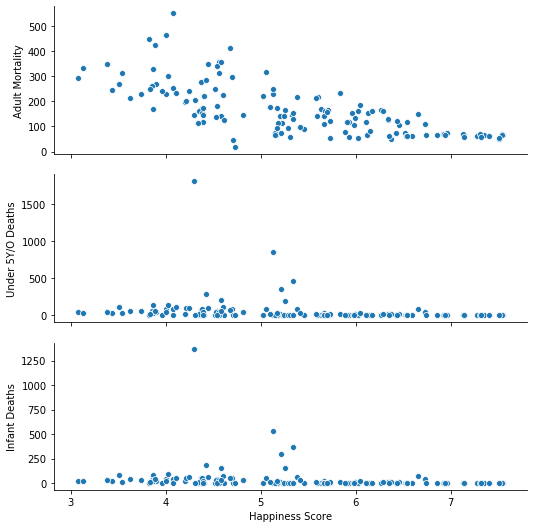

In [89]:
sns.pairplot(df_happiness_lifeExpectancy_explore,
y_vars=['Adult Mortality', 'Under 5Y/O Deaths','Infant Deaths'],
x_vars=['Happiness Score'],aspect=3)

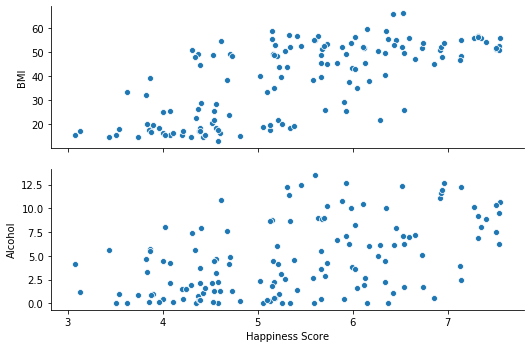

In [90]:
sns.pairplot(df_happiness_lifeExpectancy_explore,
y_vars=['BMI', 'Alcohol'],
x_vars=['Happiness Score'],aspect=3)

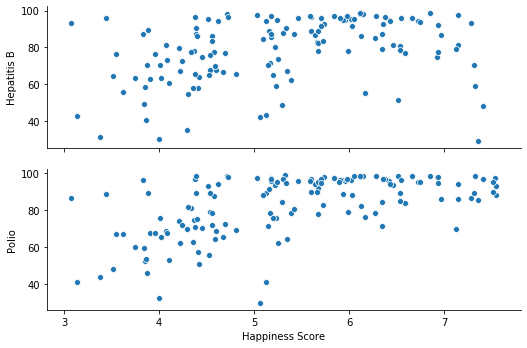

In [91]:
sns.pairplot(df_happiness_lifeExpectancy_explore,
y_vars=['Hepatitis B', 'Polio'],
x_vars=['Happiness Score'],aspect=3)

In [92]:
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore
df_happiness_lifeExpectancy_explore_2['z_score_Ad']=stats.zscore(df_happiness_lifeExpectancy_explore_2['Adult Mortality'])
df_happiness_lifeExpectancy_explore_2['z_score_UN5']=stats.zscore(df_happiness_lifeExpectancy_explore_2['Under 5Y/O Deaths'])
df_happiness_lifeExpectancy_explore_2['z_score_Inf_D']=stats.zscore(df_happiness_lifeExpectancy_explore_2['Infant Deaths'])
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_Ad'].abs()<=5]
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_UN5'].abs()<=4]
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_Inf_D'].abs()<=5]

In [93]:
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_Ad'].abs()<=5]
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_UN5'].abs()<=4]
df_happiness_lifeExpectancy_explore_2 = df_happiness_lifeExpectancy_explore_2.loc[df_happiness_lifeExpectancy_explore_2['z_score_Inf_D'].abs()<=5]

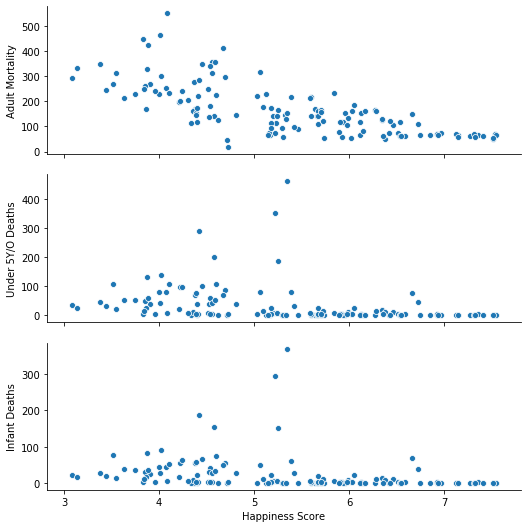

In [94]:
sns.pairplot(df_happiness_lifeExpectancy_explore_2,
y_vars=['Adult Mortality', 'Under 5Y/O Deaths','Infant Deaths'],
x_vars=['Happiness Score'],aspect=3)

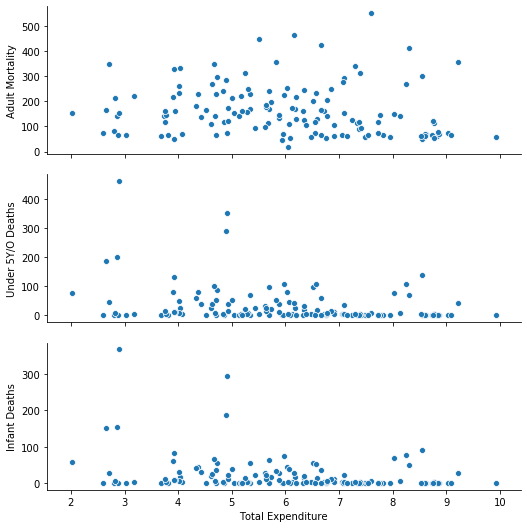

In [95]:
sns.pairplot(df_happiness_lifeExpectancy_explore_2,
y_vars=['Adult Mortality', 'Under 5Y/O Deaths','Infant Deaths'],
x_vars=['Total Expenditure'],aspect=3)

## Exploring all merged datasets

In [96]:
df_all_merged_by_region = df_all_merged.groupby('region', as_index=False).mean()
df_all_merged_by_region

,region,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,HIV/AIDS,...,z_score_Ad,z_score_UN5,z_score_Inf_D,Adult Mortality per Population,z_score_PP,z_score_H,HB_scaled,AIDS_scaled,Suicide %,Density
0,Africa,4.322754,0.327384,0.096718,0.552116,267.726103,35.325368,54.369485,70.215774,6.391912,...,1.030306,0.028822,-0.001334,0.073838,-0.423732,0.172080,0.591279,0.191571,16.579412,36.462935
1,Americas,6.318625,0.499368,0.115156,1.005568,121.613281,10.539062,12.253906,82.507338,0.236719,...,-0.430651,-0.209118,-0.191183,0.063508,0.842774,0.931188,0.766957,0.004163,17.250000,32.906150
2,Asia,5.167580,0.412400,0.145155,0.903180,157.706250,16.078125,20.540625,85.817809,0.191563,...,-0.069764,-0.162301,-0.148757,0.036080,0.077278,-0.268874,0.814272,0.002788,15.190000,48.595098
3,Europe,6.030476,0.396994,0.131432,1.217296,104.791667,0.720238,0.851190,81.093597,0.120833,...,-0.598848,-0.273540,-0.266390,0.036212,0.039242,-0.519896,0.746751,0.000634,26.490476,59.668916
4,Oceania,7.294600,0.611413,0.357294,1.356197,67.343750,0.500000,0.687500,81.793750,0.100000,...,-0.973283,-0.274465,-0.268076,0.009946,0.124684,-0.626042,0.756758,0.000000,20.350000,9.193995


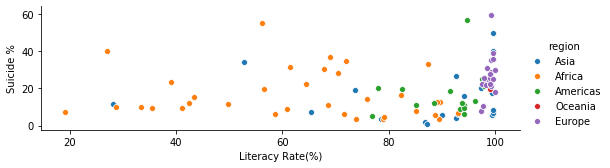

In [97]:
sns.pairplot(df_all_merged,
y_vars=['Suicide %'],
x_vars=['Literacy Rate(%)'],aspect=3 ,hue='region')

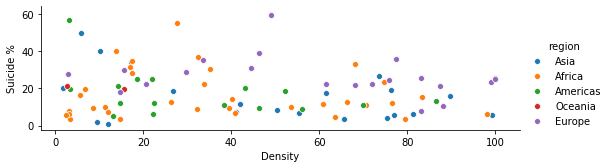

In [98]:
sns.pairplot(df_all_merged,
y_vars=['Suicide %'],
x_vars=['Density'],aspect=3 ,hue='region')

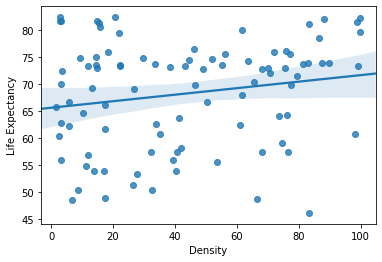

In [99]:
regplot_Homicide_population = sns.regplot(x=df_all_merged['Density'], y=df_all_merged['Life Expectancy'])

In [100]:
df_all_merged= df_all_merged[df_all_merged['Density']<100]
df_all_merged

,name,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,HIV/AIDS,...,z_score_Ad,z_score_UN5,z_score_Inf_D,Adult Mortality per Population,z_score_PP,z_score_H,HB_scaled,AIDS_scaled,Suicide %,Density
0,Afghanistan,3.51280,0.117924,0.058094,0.357113,269.0625,78.2500,107.5625,64.562500,0.10000,...,1.043668,0.329346,0.327444,0.009801,-0.741867,-0.152687,0.510479,0.000000,11.5,42.088153
2,Algeria,5.66760,0.178437,0.146099,1.012963,108.1875,20.3125,23.5000,78.000000,0.10000,...,-0.564893,-0.145581,-0.116324,0.003107,0.134878,-0.651861,0.702536,0.000000,3.8,14.620135
3,Angola,3.87225,0.027433,0.071570,0.798380,328.5625,83.7500,132.6250,70.222222,2.36875,...,1.638599,0.470942,0.369571,0.015195,-0.446220,0.148539,0.591371,0.069077,28.0,17.344080
4,Argentina,6.45940,0.481620,0.064308,1.111035,106.0000,10.1250,11.3750,81.285714,0.10000,...,-0.586766,-0.214084,-0.194354,0.002656,-0.018042,-0.238752,0.749497,0.000000,21.3,14.355527
5,Armenia,4.39320,0.216029,0.038767,0.839133,117.3750,1.0000,1.0000,87.562500,0.10000,...,-0.473029,-0.272699,-0.264247,0.039776,0.155268,-0.557190,0.839208,0.000000,5.9,99.213340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,Uruguay,6.43120,0.574978,0.188516,1.135558,119.9375,0.5625,0.7500,94.312500,0.10000,...,-0.447407,-0.274112,-0.267598,0.035806,1.348049,-0.032197,0.935683,0.000000,25.2,18.502846
135,Uzbekistan,6.04620,0.655988,0.267424,0.723758,184.8125,21.9375,25.6875,95.642857,0.20625,...,0.201267,-0.133222,-0.103878,0.006707,0.032931,-0.393668,0.954698,0.003235,17.3,61.590334
136,Yemen,3.62580,0.244175,0.067045,0.489313,211.8125,39.3750,51.6250,55.687500,0.10000,...,0.471235,0.013316,0.029684,0.009747,-0.955956,-0.298997,0.383632,0.000000,7.3,41.158569
137,Zambia,4.58440,0.462099,0.097337,0.571761,354.3125,33.4375,52.3750,69.818182,11.93125,...,1.896069,0.017554,-0.015794,0.027548,-0.303494,0.208784,0.585596,0.360228,31.6,17.089111


In [101]:
df_all_merged[df_all_merged['Density']>1000]['Population']

Series([], Name: Population, dtype: float64)

In [102]:
df_all_merged[df_all_merged['Suicide %']>25].groupby('region', as_index=False).count()

,region,name,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,...,z_score_Ad,z_score_UN5,z_score_Inf_D,Adult Mortality per Population,z_score_PP,z_score_H,HB_scaled,AIDS_scaled,Suicide %,Density
0,Africa,8,8,8,8,8,8,8,8,8,...,8,8,8,8,8,8,8,8,8,8
1,Americas,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
2,Asia,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
3,Europe,11,11,11,11,11,11,11,11,11,...,11,11,11,11,11,11,11,11,11,11


In [103]:
df_all_merged.cov()

,Happiness Score,Freedom,Trust,GDP,Adult Mortality,Infant Deaths,Under 5Y/O Deaths,Hepatitis B,HIV/AIDS,Population,...,z_score_Ad,z_score_UN5,z_score_Inf_D,Adult Mortality per Population,z_score_PP,z_score_H,HB_scaled,AIDS_scaled,Suicide %,Density
Happiness Score,1.288362e+00,0.111349,0.057568,0.355548,-8.326280e+01,-1.370082e+01,-2.179470e+01,7.335649e+00,-2.412416e+00,2.654967e+06,...,-8.325307e-01,-1.231334e-01,-1.049404e-01,-0.013646,3.160638e-01,-1.669013e-01,0.104845,-0.073451,1.223856e+00,-2.105324e+00
Freedom,1.113493e-01,0.022671,0.007586,0.021680,-3.976551e+00,-1.158199e+00,-1.778012e+00,6.947433e-01,-4.504571e-02,-2.304879e+05,...,-3.976086e-02,-1.004522e-02,-8.871137e-03,0.001277,1.802741e-02,2.295771e-03,0.009930,-0.001372,3.007900e-02,-4.607587e-01
Trust,5.756843e-02,0.007586,0.008582,0.014072,-2.910039e+00,-3.693229e-01,-5.565743e-01,4.147611e-02,-7.413541e-02,-1.151049e+05,...,-2.909699e-02,-3.144474e-03,-2.828801e-03,-0.000204,-9.760566e-03,-1.730752e-02,0.000593,-0.002257,4.804402e-02,-7.200807e-01
GDP,3.555482e-01,0.021680,0.014072,0.147253,-2.615673e+01,-5.720376e+00,-9.108123e+00,2.764332e+00,-6.361806e-01,2.322629e+05,...,-2.615367e-01,-5.145810e-02,-4.381480e-02,-0.002766,1.359844e-01,-8.694261e-02,0.039509,-0.019370,1.575857e-01,2.367934e-01
Adult Mortality,-8.326280e+01,-3.976551,-2.910039,-26.156730,1.101312e+04,1.150037e+03,1.834164e+03,-5.055133e+02,4.372666e+02,-1.339223e+08,...,1.101183e+02,1.036246e+01,8.808622e+00,3.755721,-9.428083e+00,3.650658e+01,-7.225092,13.313541,1.614401e+02,-5.655115e+02
Infant Deaths,-1.370082e+01,-1.158199,-0.369323,-5.720376,1.150037e+03,8.001949e+02,1.206216e+03,-1.326186e+02,1.765324e+01,3.997655e+08,...,1.149902e+01,6.814752e+00,6.129033e+00,-0.708101,-6.845851e+00,2.738892e+00,-1.895462,0.537492,1.272596e+00,4.146933e+01
Under 5Y/O Deaths,-2.179470e+01,-1.778012,-0.556574,-9.108123,1.834164e+03,1.206216e+03,1.850189e+03,-2.230405e+02,2.960324e+01,5.154285e+08,...,1.833950e+01,1.045300e+01,9.238925e+00,-1.012992,-1.148189e+01,3.551753e+00,-3.187825,0.901335,6.483116e+00,3.468737e+01
Hepatitis B,7.335649e+00,0.694743,0.041476,2.764332,-5.055133e+02,-1.326186e+02,-2.230405e+02,2.680847e+02,-1.859019e+01,8.164357e+06,...,-5.054542e+00,-1.260110e+00,-1.015782e+00,0.088607,5.457375e+00,6.134860e-01,3.831624,-0.566019,-1.210791e+01,7.616580e+01
HIV/AIDS,-2.412416e+00,-0.045046,-0.074135,-0.636181,4.372666e+02,1.765324e+01,2.960324e+01,-1.859019e+01,3.283342e+01,-1.413897e+07,...,4.372155e+00,1.672492e-01,1.352137e-01,0.332390,2.256128e-01,2.200219e+00,-0.265702,0.999685,1.623411e+00,-2.775359e+01
Population,2.654967e+06,-230487.924172,-115104.941019,232262.938848,-1.339223e+08,3.997655e+08,5.154285e+08,8.164357e+06,-1.413897e+07,7.338661e+14,...,-1.339066e+06,2.912013e+06,3.061974e+06,-857668.431774,2.038627e+06,3.109485e+06,116689.767683,-430492.071772,-4.062966e+07,1.378453e+08


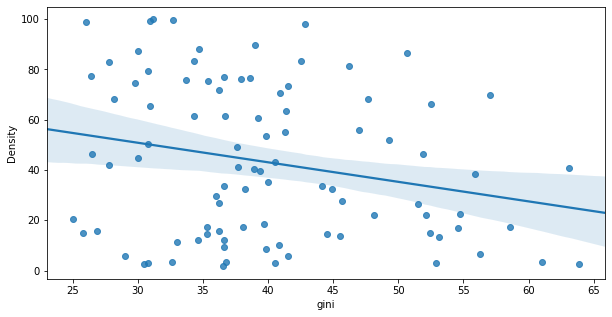

In [104]:
df_all_merged['Suicide %'] = df_all_merged['FemaleSuicide %'] + df_all_merged['MaleSuicide %']
area_col = df_all_merged[['area']].values.astype(float)
pop_col = df_all_merged[['Population']].values.astype(float)
density = pop_col/area_col
df_all_merged['Density'] = density

fig,(ax1)= plt.subplots(figsize=(10,5))

regplot_GDP = sns.regplot(x=df_all_merged['gini'], y=df_all_merged['Density'], ax=ax1)